In [1]:
import os
import torch
import numpy as np
import pandas as pd
import anndata as ad
import scanpy as sc
import scipy.sparse as sp
from sklearn import metrics
import multiprocessing as mp
from GraphST import GraphST
# from GraphST_1 import GraphST as GS1
from h5py import File

2025-01-08 16:23:03.164153: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-08 16:23:03.164194: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-08 16:23:03.165125: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-08 16:23:03.827145: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


In [2]:
import anndata2ri

<h1>image read function for visualization</h1>

In [3]:
from matplotlib.image import imread
import json
from pathlib import Path, PurePath

def put_image(adata, path, library_id, arr_col=True):
    path = path + '/' + library_id
    source_image_path = path + '/' + str(library_id)
    adata.uns["spatial"] = dict()
    # from h5py import File
    
    # with File(path / count_file, mode="r") as f:
    #     attrs = dict(f.attrs)
    # if library_id is None:
    #     library_id = str(attrs.pop("library_ids")[0], "utf-8")
    adata.uns["spatial"][library_id] = dict()
    tissue_positions_file = path + "/spatial/tissue_positions_list.csv"
    files = dict(
        tissue_positions_file=tissue_positions_file,
        scalefactors_json_file=path + "/spatial/scalefactors_json.json",
        hires_image=path + "/spatial/tissue_hires_image.png",
        lowres_image=path + "/spatial/tissue_lowres_image.png",
    )
    # check if files exists, continue if images are missing
    # for f in files.values():
    #     if not f.exists():
    #         if any(x in str(f) for x in ["hires_image", "lowres_image"]):
    #             logg.warning(
    #                 f"You seem to be missing an image file.\n"
    #                 f"Could not find '{f}'."
    #             )
    #         else:
    #             raise OSError(f"Could not find '{f}'")
    
    adata.uns["spatial"][library_id]["images"] = dict()
    # for res in ["hires", "lowres"]:
    for res in ["lowres"]:
        try:
            adata.uns["spatial"][library_id]["images"][res] = imread(
                str(files[f"{res}_image"])
            )
        except Exception:
            raise OSError(f"Could not find '{res}_image'")
    
    # read json scalefactors
    adata.uns["spatial"][library_id]["scalefactors"] = json.loads(
        Path(files["scalefactors_json_file"]).read_text()
    )
    
    # adata.uns["spatial"][library_id]["metadata"] = {
    #     k: (str(attrs[k], "utf-8") if isinstance(attrs[k], bytes) else attrs[k])
    #     for k in ("chemistry_description", "software_version")
    #     if k in attrs
    # }
    
    # read coordinates
    positions = pd.read_csv(
        files["tissue_positions_file"],
        header= None,
        index_col=0,
    )
    positions.columns = [
        "in_tissue",
        "array_row",
        "array_col",
        "pxl_col_in_fullres",
        "pxl_row_in_fullres",
    ]
    if arr_col:
        adata.obs = adata.obs.join(positions, how="left")
        
        adata.obsm["spatial"] = adata.obs[
            ["pxl_row_in_fullres", "pxl_col_in_fullres"]
        ].to_numpy()
        adata.obs.drop(
            columns=["pxl_row_in_fullres", "pxl_col_in_fullres"],
            inplace=True,
        )
    
    # put image path in uns
    # if source_image_path is not None:
    #     # get an absolute path
    #     source_image_path = str(Path(source_image_path).resolve())
    #     adata.uns["spatial"][library_id]["metadata"]["source_image_path"] = str(
    #         source_image_path
    #     )

    return adata

In [4]:
os.getcwd()

'/workspace/volume/spatial_integration/GNN_based/combined/New/Reworked_flow'

<h1>Data Loading</h1>

In [5]:
datasets = ['151507', '151672', '151673']
# dat = "feather"
GNs = "beer_embed_all_com3all_unfil"
data_folder = "/workspace/volume/spatial_integration/dataset/GraphST/DLPFC/samples"
new_folder = "/workspace/volume/spatial_integration/GNN_based/combined/processed_data/"
h5_folder = "/workspace/volume/spatial_integration/GNN_based/combined/New/Reworked_flow/dataset/samples/"
dataset_folder = "/workspace/volume/spatial_integration/GNN_based/combined/New/Reworked_flow/dataset/"

In [6]:
device = torch.device('cuda:1' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda', index=1)

In [7]:
# get beer processed seurat object in anndata format
# beer = sc.read_h5ad('/workspace/volume/spatial_integration/GNN_based/combined/beer_export/240624_com3all_beer.h5ad')
beer = sc.read_h5ad(h5_folder + GNs +'.h5ad')
beer

/opt/conda/lib/python3.10/site-packages/anndata/compat/__init__.py:229: FutureWarning: Moving element from .uns['neighbors']['distances'] to .obsp['distances'].

This is where adjacency matrices should go now.
  warn(


AnnData object with n_obs × n_vars = 11880 × 1952
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric'
    var: 'features'
    uns: 'neighbors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances'

In [8]:
!ls $data_folder/151507/spatial

full_image.tif		tissue_hires_image.png	 tissue_positions_list.csv
scalefactors_json.json	tissue_lowres_image.png


In [9]:
embed_data = {}
for dataset in datasets:
    embed_data[dataset] = pd.read_feather(dataset_folder + f"{dataset}_com3all.feather")

In [10]:
# # our pipeline output before BEER batch effect removal
# if dat== "feather":
#     if dataset == '151673':
#         embed_data = pd.read_feather(new_folder+"5thset_embed_673.feather")
#     elif dataset == '151674':
#         embed_data = pd.read_feather(new_folder+"5thset_embed_674.feather")
#     elif dataset == '151675':
#         embed_data = pd.read_feather(new_folder+"5thset_embed_675.feather")
#     elif dataset == '151676':
#         embed_data = pd.read_feather(new_folder+"5thset_embed_676.feather")
# else:
#     if dataset == '151673':
#         embed_data = pd.read_csv(new_folder+"embed_673.csv", index_col=0)
#     elif dataset == '151674':
#         embed_data = pd.read_csv(new_folder+"embed_674.csv", index_col=0)
#     elif dataset == '151675':
#         embed_data = pd.read_csv(new_folder+"embed_675.csv", index_col=0)
#     elif dataset == '151676':
#         embed_data = pd.read_csv(new_folder+"embed_676.csv", index_col=0)

In [11]:
beer.obs['batch_numeric'].value_counts()

batch_numeric
1    4226
2    4015
3    3639
Name: count, dtype: int64

In [12]:
beer.obs.head()

,orig.ident,nCount_RNA,nFeature_RNA,batch,group,map,RNA_snn_res.0.8,seurat_clusters,RNA_snn_res.0.5,batch_numeric,ident_numeric
AAACAACGAATAGTTC-1,Layer1,18664.945522,34265,Batch 1,Batch 1_9,NA,6,3,3,1,1
AAACAAGTATCTCCCA-1,Layer3,19338.852753,35708,Batch 1,Batch 1_24,V1,2,1,1,1,2
AAACAATCTACTAGCA-1,Layer1,18970.172933,34631,Batch 1,Batch 1_45,V1,6,3,3,1,1
AAACACCAATAACTGC-1,WM,19379.806191,35434,Batch 1,Batch 1_46,V1,9,4,4,1,3
AAACAGCTTTCAGAAG-1,Layer6,19216.967304,35158,Batch 1,Batch 1_14,NA,8,6,6,1,4


In [13]:
beer_active = {}
for i, dataset in enumerate(datasets):
    beer_active[dataset] = beer[beer.obs['batch_numeric']==i+1]

In [14]:
# # Beer_1, beer_2, or beer_3 corresponds to batch numeric 1, 2, and 3
# if dataset == '151673':
#     # beer_1 673
#     beer_active = beer[beer.obs['batch_numeric']==1]
# elif dataset == '151674':
#     # beer_2 674
#     beer_active = beer[beer.obs['batch_numeric']==2]
# elif dataset == '151675':
#     # beer_3 675
#     beer_active = beer[beer.obs['batch_numeric']==3]
# elif dataset == '151676':
#     # beer_4 676
#     beer_active = beer[beer.obs['batch_numeric']==4]

# beer_active

In [15]:
data_folder

'/workspace/volume/spatial_integration/dataset/GraphST/DLPFC/samples'

In [16]:
new_beer_active = {}
beer_active_combine = {}
adata_test = {}
adata_true = {}

for dataset in datasets:
    dataset_folder = data_folder + '/' + dataset + '/'
    
    beer_active[dataset].obs.index = embed_data[dataset].columns.values
    new_beer_active[dataset] = ad.AnnData(X=beer_active[dataset].raw.X, obs=beer_active[dataset].obs, var=beer_active[dataset].raw.var)

    beer_active[dataset] = put_image(beer_active[dataset], data_folder, dataset)
    new_beer_active[dataset] = put_image(new_beer_active[dataset], data_folder, dataset, arr_col=True)
    
    beer_active_combine[dataset] = beer_active[dataset].copy()

    sparse_embed = sp.csr_matrix(embed_data[dataset].T.values, dtype=np.float32)
    obs = pd.DataFrame(index=embed_data[dataset].columns)
    var = pd.DataFrame(index=embed_data[dataset].index)
    
    # construct adata from our embedded gene+spatial matrix
    adata_test[dataset] = ad.AnnData(X=sparse_embed, obs=obs, var=var)
    adata_test[dataset] = put_image(adata_test[dataset], data_folder, dataset)

    adata_true[dataset] = sc.read_visium(dataset_folder, count_file='filtered_feature_bc_matrix.h5', load_images=True)
    adata_true[dataset].var_names_make_unique()

/tmp/ipykernel_349741/3824997846.py:8: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["spatial"] = dict()
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/tmp/ipykernel_349741/3824997846.py:8: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["spatial"] = dict()
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/tmp/ipykernel_349741/3824997846.py:8: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns["spatial"] = dict()
/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1832: Us

In [17]:
beer_active

{'151507': AnnData object with n_obs × n_vars = 4226 × 1952
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: 'features'
     uns: 'neighbors', 'spatial'
     obsm: 'X_pca', 'X_umap', 'spatial'
     varm: 'PCs'
     obsp: 'distances',
 '151672': AnnData object with n_obs × n_vars = 4015 × 1952
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: 'features'
     uns: 'neighbors', 'spatial'
     obsm: 'X_pca', 'X_umap', 'spatial'
     varm: 'PCs'
     obsp: 'distances',
 '151673': AnnData object with n_obs × n_vars = 3639 × 1952
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5'

In [18]:
adata_true

{'151507': AnnData object with n_obs × n_vars = 4226 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial',
 '151672': AnnData object with n_obs × n_vars = 4015 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial',
 '151673': AnnData object with n_obs × n_vars = 3639 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome'
     uns: 'spatial'
     obsm: 'spatial'}

In [19]:
adata_test

{'151507': AnnData object with n_obs × n_vars = 4226 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     uns: 'spatial'
     obsm: 'spatial',
 '151672': AnnData object with n_obs × n_vars = 4015 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     uns: 'spatial'
     obsm: 'spatial',
 '151673': AnnData object with n_obs × n_vars = 3639 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     uns: 'spatial'
     obsm: 'spatial'}

In [20]:
new_beer_active

{'151507': AnnData object with n_obs × n_vars = 4226 × 67076
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: '_index'
     uns: 'spatial'
     obsm: 'spatial',
 '151672': AnnData object with n_obs × n_vars = 4015 × 67076
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: '_index'
     uns: 'spatial'
     obsm: 'spatial',
 '151673': AnnData object with n_obs × n_vars = 3639 × 67076
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: '_index'
     uns: 'spatial'
     obsm: 'spatial'}

<b>adata_true</b> -> Count file visium <br>
<b>adata_test</b> -> Our pipeline's spatial module output without batch effect removal <br>
<b>beer_active</b> -> Our pipeline output with only differentially expressed gene <br>
<b>new_beer_active</b> -> Our pipeline output but includes all gene features 

<h2>run graphst</h2>

In [21]:
for dataset in datasets:
    print(f'training adata_true for {dataset}')
    model = GraphST.GraphST(adata_true[dataset], device=device)
    adata_true[dataset] = model.train()

    print(f'training adata_test for {dataset}')
    model1 = GraphST.GraphST(adata_test[dataset], device=device)
    adata_test[dataset] = model1.train()

    print(f'training new_beer_active for {dataset}')
    model2 = GraphST.GraphST(new_beer_active[dataset], device=device)
    new_beer_active[dataset] = model2.train()

training adata_true for 151507
Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:23<00:00, 25.67it/s]


Optimization finished for ST data!
training adata_test for 151507


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:13<00:00, 43.66it/s]


Optimization finished for ST data!
training new_beer_active for 151507


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:13<00:00, 44.33it/s]


Optimization finished for ST data!
training adata_true for 151672
Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:12<00:00, 47.60it/s]


Optimization finished for ST data!
training adata_test for 151672


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:12<00:00, 49.56it/s]


Optimization finished for ST data!
training new_beer_active for 151672


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:11<00:00, 50.03it/s]


Optimization finished for ST data!
training adata_true for 151673
Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:11<00:00, 53.26it/s]


Optimization finished for ST data!
training adata_test for 151673


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:10<00:00, 55.53it/s]


Optimization finished for ST data!
training new_beer_active for 151673


/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:62: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


Begin to train ST data...


100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:10<00:00, 55.47it/s]


Optimization finished for ST data!


In [22]:
adata_true

{'151507': AnnData object with n_obs × n_vars = 4226 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151672': AnnData object with n_obs × n_vars = 4015 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151673': AnnData object with n_obs × n_vars = 3639 × 33538
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'varia

In [23]:
adata_test

{'151507': AnnData object with n_obs × n_vars = 4226 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151672': AnnData object with n_obs × n_vars = 4015 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151673': AnnData object with n_obs × n_vars = 3639 × 67076
     obs: 'in_tissue', 'array_row', 'array_col'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', '

In [24]:
new_beer_active

{'151507': AnnData object with n_obs × n_vars = 4226 × 67076
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: '_index', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151672': AnnData object with n_obs × n_vars = 4015 × 67076
     obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col'
     var: '_index', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh',

In [25]:
model1 = GS1.GraphST(adata_test, device=device)
adata_test = model1.train()

/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:12<00:00, 46.85it/s]

Optimization finished for ST data!


In [26]:
model2 = GS1.GraphST(new_beer_active, device=device)
new_beer_active = model2.train()

/opt/conda/lib/python3.10/site-packages/scanpy/preprocessing/_highly_variable_genes.py:216: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  disp_grouped = df.groupby('mean_bin')['dispersions']


Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:13<00:00, 44.90it/s]

Optimization finished for ST data!


In [23]:
beer_active['151507'].obs['orig.ident']

AAACAACGAATAGTTC-1    Layer1
AAACAAGTATCTCCCA-1    Layer3
AAACAATCTACTAGCA-1    Layer1
AAACACCAATAACTGC-1        WM
AAACAGCTTTCAGAAG-1    Layer6
                       ...  
TTGTTGTGTGTCAAGA-1    Layer3
TTGTTTCACATCCAGG-1    Layer6
TTGTTTCATTAGTCTA-1        WM
TTGTTTCCATACAACT-1    Layer6
TTGTTTGTGTAAATTC-1    Layer1
Name: orig.ident, Length: 4226, dtype: object

In [25]:
layer_labels = {}
for dataset in datasets:
    # layer_labels[dataset] = beer_active[dataset].obs['orig.ident']
    adata_true[dataset].obs['ground_truth'] = beer_active[dataset].obs['orig.ident']
    adata_test[dataset].obs['ground_truth'] = beer_active[dataset].obs['orig.ident']
    beer_active[dataset].obs['ground_truth'] = beer_active[dataset].obs['orig.ident']
    new_beer_active[dataset].obs['ground_truth'] = beer_active[dataset].obs['orig.ident']
    beer_active_combine[dataset].obs['ground_truth'] = beer_active[dataset].obs['orig.ident']

In [27]:
layer_labels['151507'].values

array(['Layer1', 'Layer3', 'Layer1', ..., 'WM', 'Layer6', 'Layer1'],
      dtype=object)

In [32]:
adata_true['151673'].obs['ground_truth']

AAACAAGTATCTCCCA-1    Layer3
AAACAATCTACTAGCA-1    Layer1
AAACACCAATAACTGC-1        WM
AAACAGAGCGACTCCT-1    Layer3
AAACAGCTTTCAGAAG-1    Layer5
                       ...  
TTGTTTCACATCCAGG-1        WM
TTGTTTCATTAGTCTA-1        WM
TTGTTTCCATACAACT-1    Layer6
TTGTTTGTATTACACG-1        WM
TTGTTTGTGTAAATTC-1    Layer2
Name: ground_truth, Length: 3639, dtype: object

In [26]:
adata_true

{'151507': AnnData object with n_obs × n_vars = 4226 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151672': AnnData object with n_obs × n_vars = 4015 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151673': AnnData object with n_obs × n_vars = 3639 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_va

In [27]:
adata_test

{'151507': AnnData object with n_obs × n_vars = 4226 × 67076
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151672': AnnData object with n_obs × n_vars = 4015 × 67076
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb',
 '151673': AnnData object with n_obs × n_vars = 3639 × 67076
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth'
     var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'l

In [27]:
# if dataset == '151673':
#     # beer_1 673
#     layer_labels = pd.read_csv('layer_673_pos.csv')
# elif dataset == '151674':
#     # beer_2 674
#     layer_labels = pd.read_csv('layer_674_pos.csv')
# elif dataset == '151675':
#     # beer_3 675
#     layer_labels = pd.read_csv('layer_675_pos.csv')
# elif dataset == '151676':
#     # beer_3 675
#     layer_labels = pd.read_csv('layer_676_pos.csv')
# layer_labels = pd.read_csv('layer_674_pos.csv')
# layer_labels change into 673,674,or 675 accordingly

In [28]:
# adata_true.obs['ground_truth']= layer_labels['layer_guess'].values

In [29]:
# adata_test.obs['ground_truth']= layer_labels['layer_guess'].values

In [30]:
# beer_active.obs['ground_truth']= layer_labels['layer_guess'].values

In [31]:
# beer_active_combine.obs['ground_truth']= layer_labels['layer_guess'].values

In [32]:
# new_beer_active.obs['ground_truth']= layer_labels['layer_guess'].values

In [33]:
os.environ['R_HOME'] = '/usr/lib/R'

In [28]:
from GraphST.utils import clustering

radius = 50
tool = 'mclust' # mclust, leiden, and louvain

for dataset in datasets:

    if dataset =='151672':
        n_clusters = 5
    else:
        n_clusters = 7

    if tool == 'mclust':
        clustering(adata_true[dataset], n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
        clustering(adata_test[dataset], n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
        clustering(new_beer_active[dataset], n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
    
    elif tool in ['leiden', 'louvain']:
        clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)
    
        

R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.1.1
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%


In [35]:
n_clusters

7

In [36]:
if tool == 'mclust':
   clustering(adata_true, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.1.1
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%


In [37]:
if tool == 'mclust':
   clustering(adata_test, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_test, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [38]:
if tool == 'mclust':
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [39]:
adata_true

AnnData object with n_obs × n_vars = 3460 × 33538
    obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth', 'mclust', 'domain'
    var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'spatial', 'hvg', 'log1p'
    obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca'

In [30]:
adata_true

{'151507': AnnData object with n_obs × n_vars = 4226 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth', 'mclust', 'domain'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca',
 '151672': AnnData object with n_obs × n_vars = 4015 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_truth', 'mclust', 'domain'
     var: 'gene_ids', 'feature_types', 'genome', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'mean', 'std'
     uns: 'spatial', 'hvg', 'log1p'
     obsm: 'spatial', 'distance_matrix', 'graph_neigh', 'adj', 'label_CSL', 'feat', 'feat_a', 'emb', 'emb_pca',
 '151673': AnnData object with n_obs × n_vars = 3639 × 33538
     obs: 'in_tissue', 'array_row', 'array_col', 'ground_trut

In [31]:
def n_mclust_R(adata, num_cluster, modelNames='EEE', used_obsm='emb_pca', random_seed=2020):
    """\
    Clustering using the mclust algorithm.
    The parameters are the same as those in the R package mclust.
    """
    
    np.random.seed(random_seed)
    import rpy2.robjects as robjects
    robjects.r.library("mclust")

    import rpy2.robjects.numpy2ri
    rpy2.robjects.numpy2ri.activate()
    r_random_seed = robjects.r['set.seed']
    r_random_seed(random_seed)
    rmclust = robjects.r['Mclust']
    
    res = rmclust(rpy2.robjects.numpy2ri.numpy2rpy(adata.obsm[used_obsm]), num_cluster, modelNames)
    mclust_res = np.array(res[-2])

    adata.obs['mclust'] = mclust_res
    adata.obs['mclust'] = adata.obs['mclust'].astype('int')
    adata.obs['mclust'] = adata.obs['mclust'].astype('category')
    return adata

In [32]:
for dataset in datasets:
    if dataset =='151672':
        n_clusters = 5
    else:
        n_clusters = 7
    beer_active[dataset] = n_mclust_R(beer_active[dataset], used_obsm='X_pca', num_cluster=n_clusters)
    beer_active[dataset].obs['domain'] = beer_active[dataset].obs['mclust']

fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%


<h2>Results ARI</h2>

<h3>Adata_true</h3>

/tmp/ipykernel_349741/3884477962.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true[dataset].uns['ARI'] = ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151507
ARI:  0.3743881436605449


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


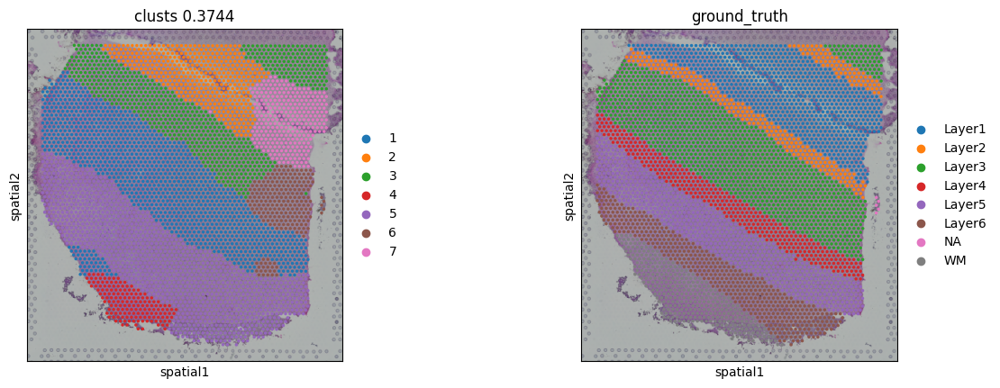

/tmp/ipykernel_349741/3884477962.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true[dataset].uns['ARI'] = ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151672
ARI:  0.5845574654910798


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


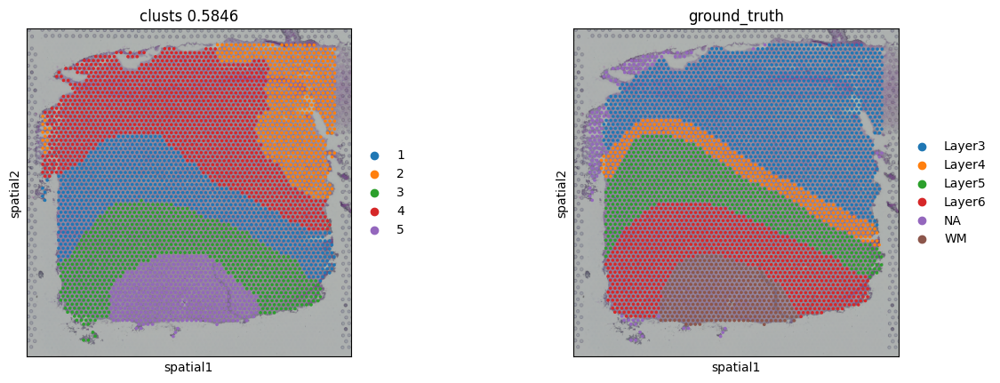

/tmp/ipykernel_349741/3884477962.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true[dataset].uns['ARI'] = ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151673
ARI:  0.632483364490049


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


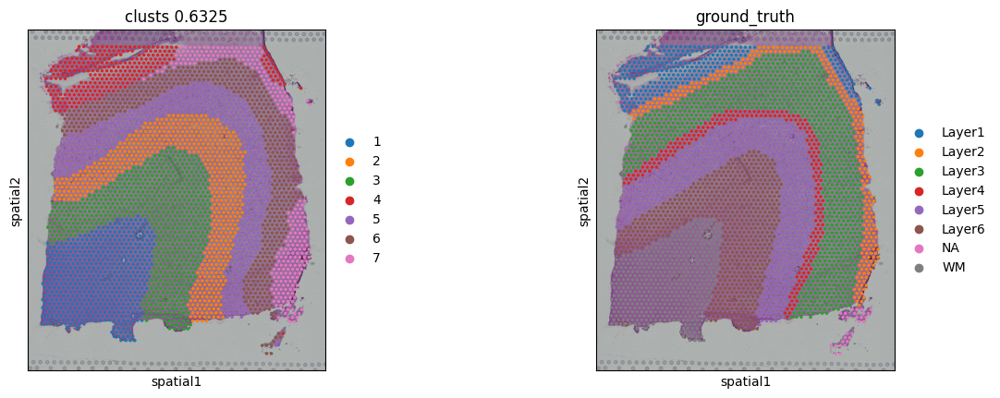

In [34]:
for dataset in datasets:
    adata_true[dataset] = adata_true[dataset][~pd.isnull(adata_true[dataset].obs['ground_truth'])]

    ARI = metrics.adjusted_rand_score(adata_true[dataset].obs['domain'], adata_true[dataset].obs['ground_truth'])
    adata_true[dataset].uns['ARI'] = ARI
    
    print('Dataset:', dataset)
    print('ARI: ', ARI)

    sc.pl.spatial(adata_true[dataset], img_key='lowres',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save=None)

<h3>Adata_test</h3>

/tmp/ipykernel_349741/1529998290.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test[dataset].uns['ARI'] = ARI


Dataset: 151507
ARI:  0.35626784381385346


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


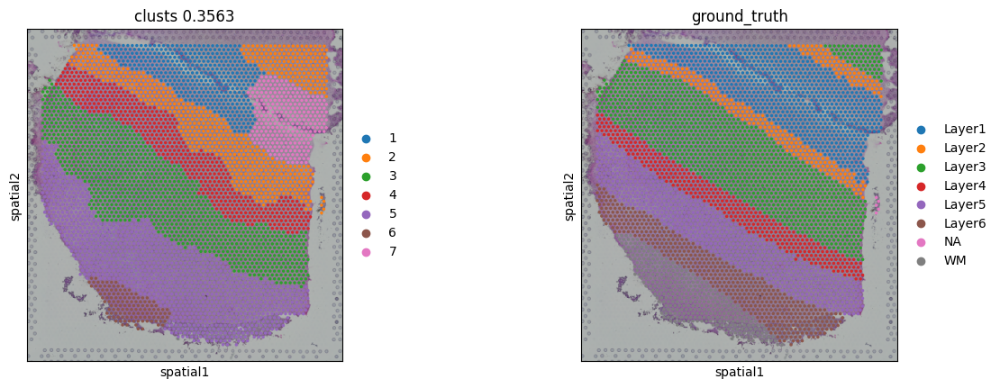

/tmp/ipykernel_349741/1529998290.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test[dataset].uns['ARI'] = ARI


Dataset: 151672
ARI:  0.45799247533755993


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


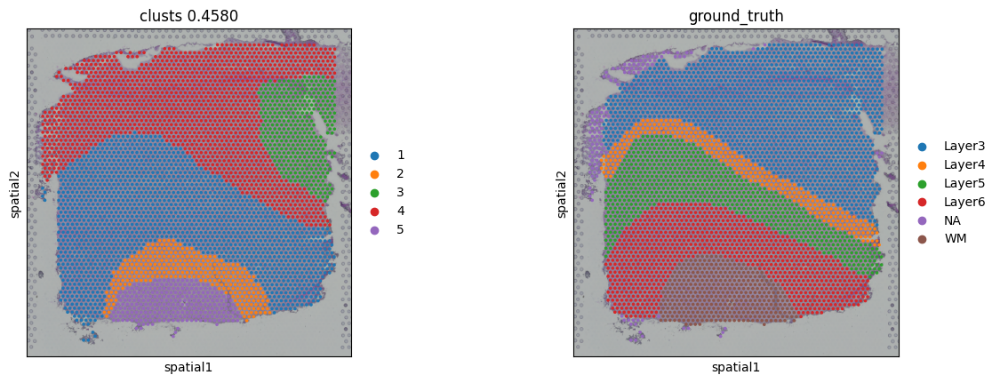

/tmp/ipykernel_349741/1529998290.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test[dataset].uns['ARI'] = ARI


Dataset: 151673
ARI:  0.20856472543855256


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


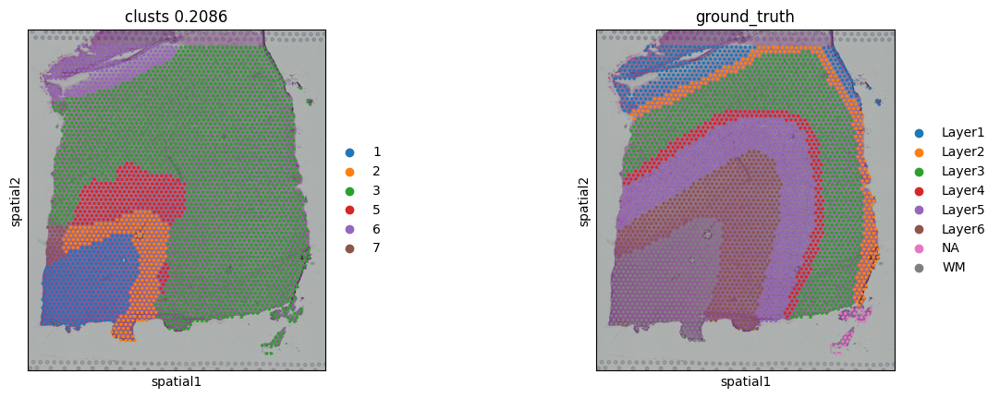

In [35]:
for dataset in datasets:
    adata_test[dataset] = adata_test[dataset][~pd.isnull(adata_test[dataset].obs['ground_truth'])]

    ARI = metrics.adjusted_rand_score(adata_test[dataset].obs['domain'], adata_test[dataset].obs['ground_truth'])
    adata_test[dataset].uns['ARI'] = ARI
    
    print('Dataset:', dataset)
    print('ARI: ', ARI)

    sc.pl.spatial(adata_test[dataset], img_key='lowres',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save=None)

<h3>beer_active</h3>

/tmp/ipykernel_349741/3768918822.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active[dataset].uns['ARI'] = ARI


Dataset: 151507
ARI:  0.33405206107093166


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


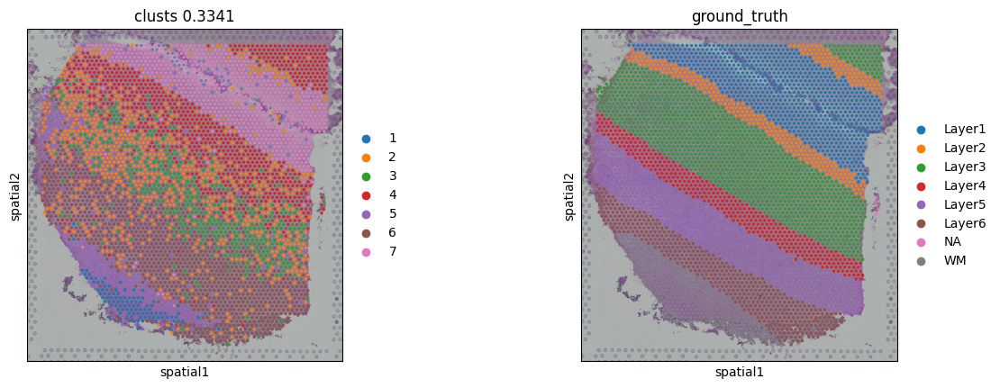

/tmp/ipykernel_349741/3768918822.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active[dataset].uns['ARI'] = ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151672
ARI:  0.36094246714852485


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


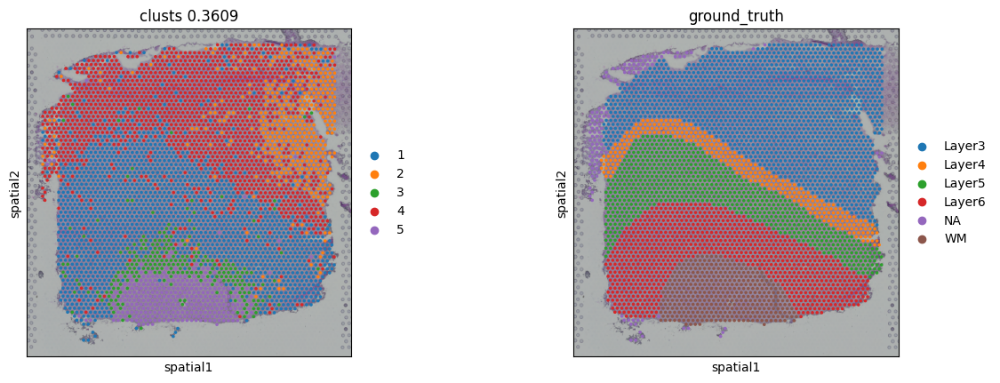

/tmp/ipykernel_349741/3768918822.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active[dataset].uns['ARI'] = ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151673
ARI:  0.35952958900895643


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


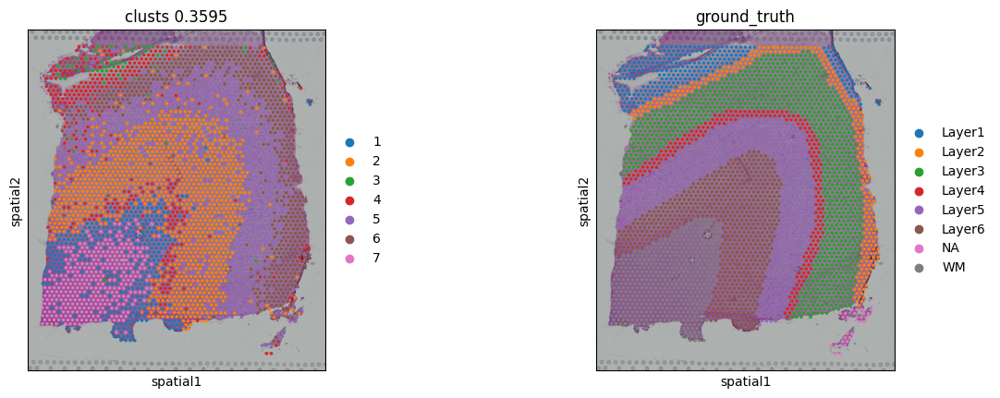

In [36]:
for dataset in datasets:
    beer_active[dataset] = beer_active[dataset][~pd.isnull(beer_active[dataset].obs['ground_truth'])]

    ARI = metrics.adjusted_rand_score(beer_active[dataset].obs['domain'], beer_active[dataset].obs['ground_truth'])
    beer_active[dataset].uns['ARI'] = ARI
    
    print('Dataset:', dataset)
    print('ARI: ', ARI)

    sc.pl.spatial(beer_active[dataset], img_key='lowres',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save=None)

<h3>new_beer_active</h3>

/tmp/ipykernel_349741/405424700.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active[dataset].uns['ARI'] = ARI


Dataset: 151507
ARI:  0.2488191655826056


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


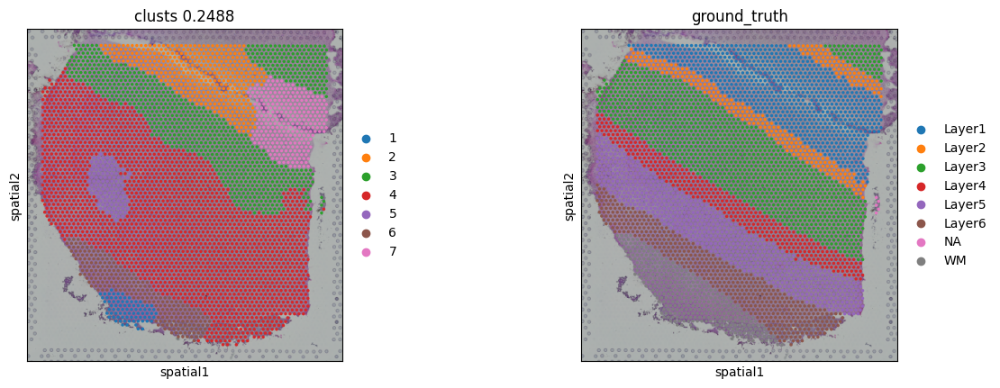

/tmp/ipykernel_349741/405424700.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active[dataset].uns['ARI'] = ARI


Dataset: 151672
ARI:  0.1506748734529903


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


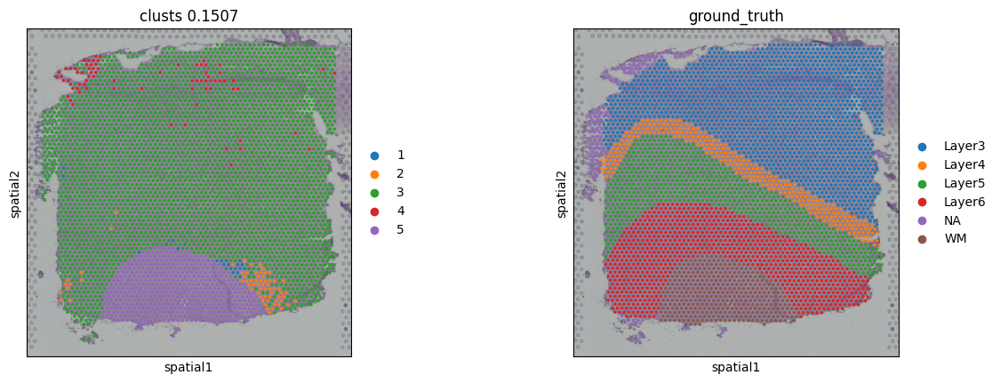

/tmp/ipykernel_349741/405424700.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active[dataset].uns['ARI'] = ARI


Dataset: 151673
ARI:  0.2874890706088264


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


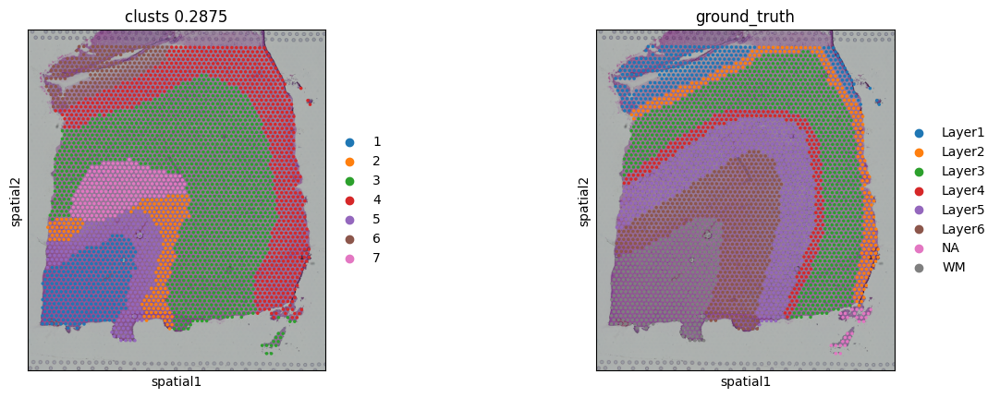

In [37]:
for dataset in datasets:
    new_beer_active[dataset] = new_beer_active[dataset][~pd.isnull(new_beer_active[dataset].obs['ground_truth'])]

    ARI = metrics.adjusted_rand_score(new_beer_active[dataset].obs['domain'], new_beer_active[dataset].obs['ground_truth'])
    new_beer_active[dataset].uns['ARI'] = ARI
    
    print('Dataset:', dataset)
    print('ARI: ', ARI)

    sc.pl.spatial(new_beer_active[dataset], img_key='lowres',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save=None)

<h3>beer_active_combine</h3>

In [39]:
# separate test using our pipeline output reprocessed with GraphST (combined)
for dataset in datasets:
    beer_active_combine[dataset].var['highly_variable']= True
    
    model3 = GraphST.GraphST(beer_active_combine[dataset], device=device, dim_input=3609) #, dim_input=4015
    beer_active_combine[dataset] = model3.train()

In [41]:
for dataset in datasets:
    if dataset =='151672':
        n_clusters = 5
    else:
        n_clusters = 7
        
    if tool == 'mclust':
       clustering(beer_active_combine[dataset], n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
    elif tool in ['leiden', 'louvain']:
       clustering(beer_active_combine[dataset], n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%
fitting ...
  |======================================================================| 100%


/tmp/ipykernel_349741/339723191.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine[dataset].uns['ARI']=ARI


Dataset: 151507
ARI:  0.5327678667244696


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


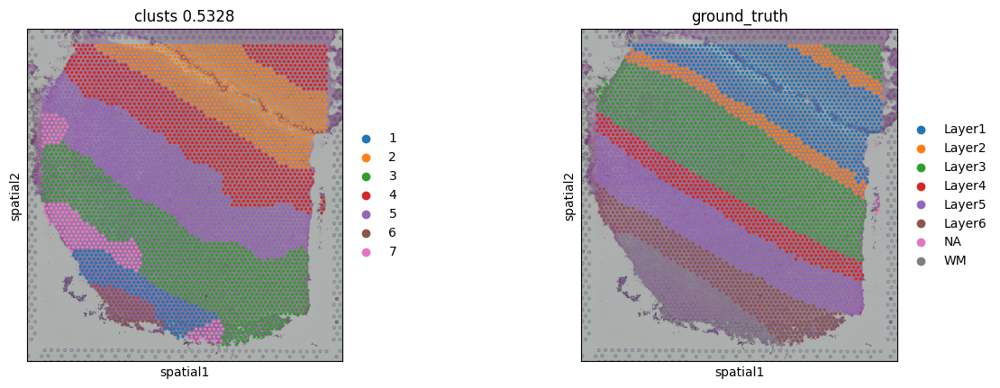

/tmp/ipykernel_349741/339723191.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine[dataset].uns['ARI']=ARI


Dataset: 151672
ARI:  0.7452032689069764


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


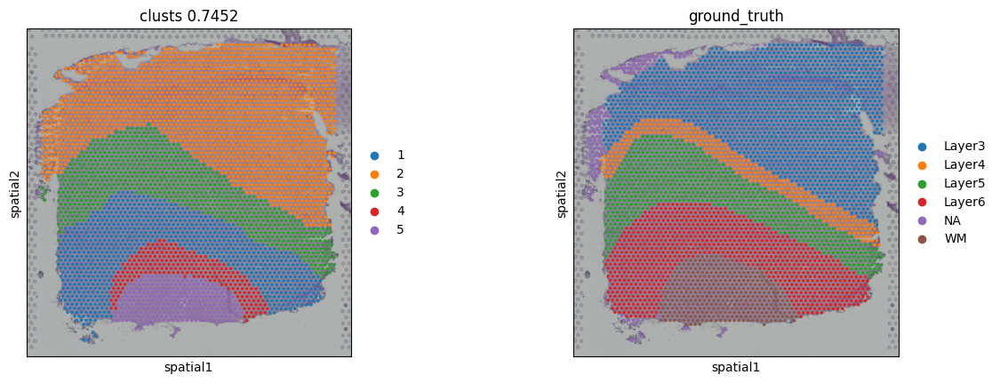

/tmp/ipykernel_349741/339723191.py:5: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine[dataset].uns['ARI']=ARI


Dataset: 151673
ARI:  0.5706642387300098


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


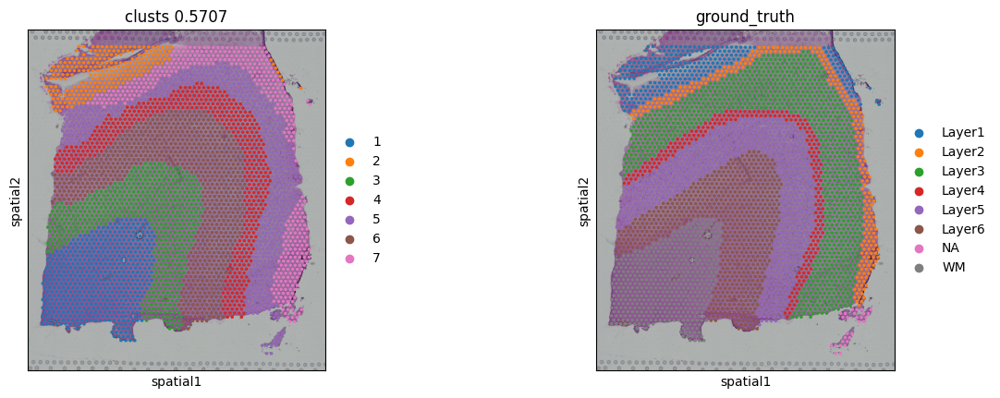

In [42]:
for dataset in datasets:
    beer_active_combine[dataset] = beer_active_combine[dataset][~pd.isnull(beer_active_combine[dataset].obs['ground_truth'])]
    
    ARI = metrics.adjusted_rand_score(beer_active_combine[dataset].obs['domain'], beer_active_combine[dataset].obs['ground_truth'])
    beer_active_combine[dataset].uns['ARI']=ARI
    
    print('Dataset:', dataset)
    print('ARI: ', ARI)

    sc.pl.spatial(beer_active_combine[dataset], img_key='lowres',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
             save=None) #'151673_combinedwbeer.png'
                                

<h1>151673 tests</h1>

In [42]:
for index in adata_test.var[adata_test.var['highly_variable']==True].index:
    if '_' in index:
        print(index)

In [43]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

Dataset: 151673
ARI:  0.6363766869926416


/tmp/ipykernel_2755068/2738171246.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


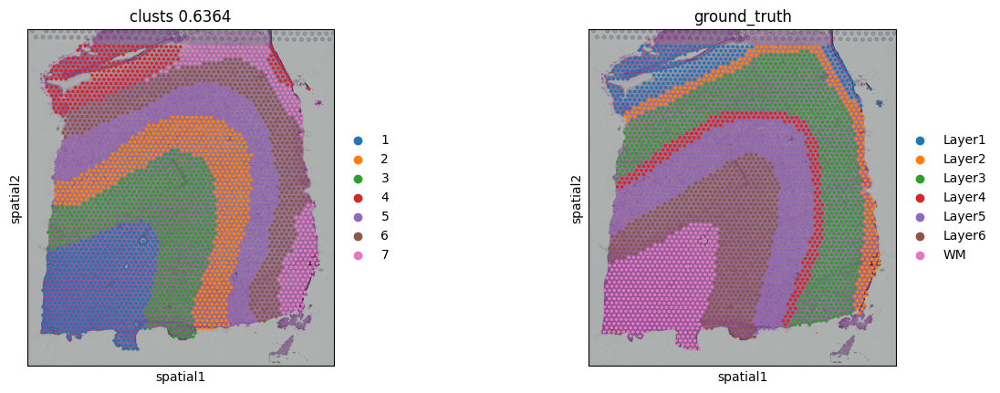

In [45]:
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save='_151673_{}_true.png'.format(GNs))

In [46]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

Dataset: 151673
ARI:  0.36328724935260454


/tmp/ipykernel_2755068/1699016852.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


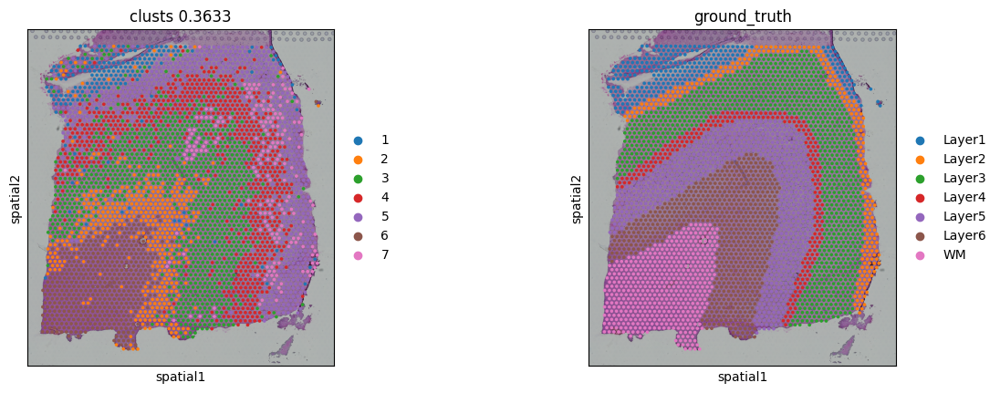

In [47]:
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151673_{}_active.png'.format(GNs))

In [48]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_2755068/281745878.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151673
ARI:  0.3467417576531631


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


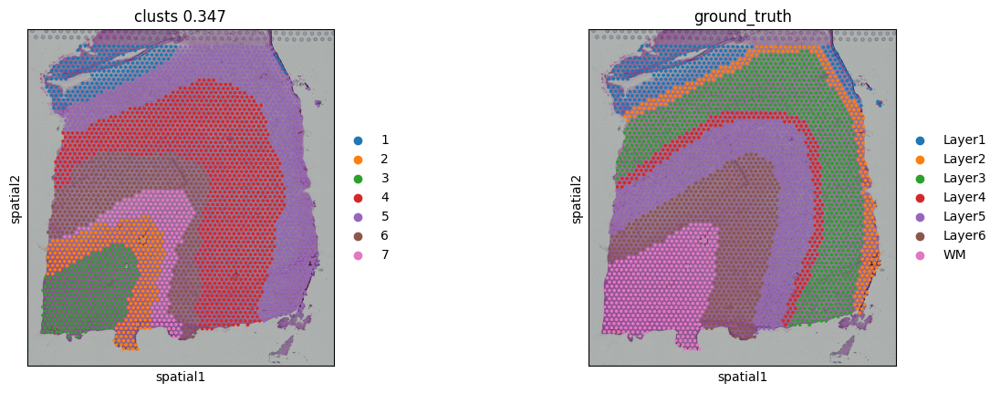

In [49]:
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True, 
              save='_151673_{}_newactive.png'.format(GNs))

In [50]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_2755068/2163609175.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151673
ARI:  0.47096766761951125


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


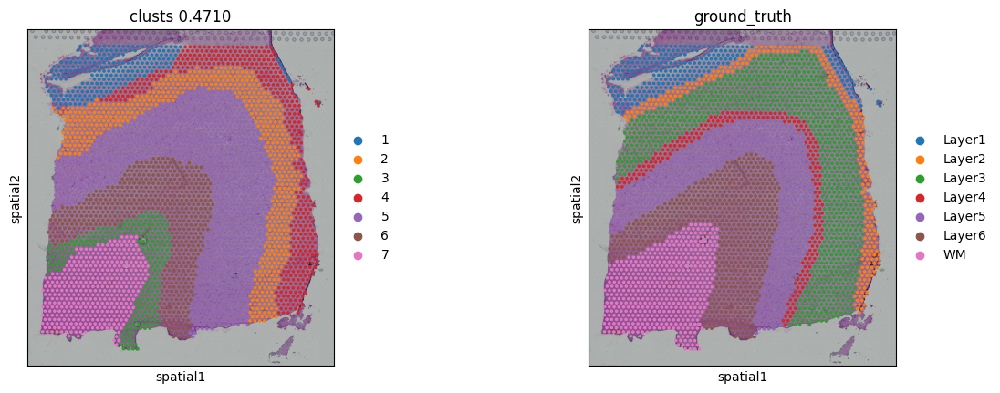

In [51]:
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
              save='_151673_{}_test.png'.format(GNs))

In [52]:
for index in beer_active_combine.var.index:
    if '_' in index:
        print(index)

In [53]:
# separate test using our pipeline output reprocessed with GraphST (combined)
beer_active_combine.var['highly_variable']= True

In [54]:
model = GraphST.GraphST(beer_active_combine, device=device, dim_input=3609) #, dim_input=4015
beer_active_combine = model.train()

Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:22<00:00, 26.37it/s]


Optimization finished for ST data!


In [55]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [56]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_2755068/1611802018.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151673
ARI:  0.3495235522448758


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


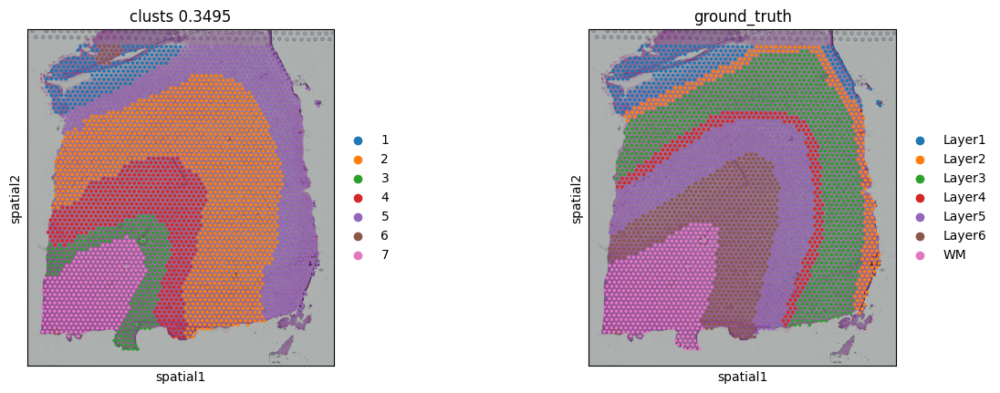

In [57]:
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True, 
             save='_151673_{}_activecombine.png'.format(GNs)) #'151673_combinedwbeer.png'

<h2>2nd run</h2>

In [58]:
if tool == 'mclust':
   clustering(adata_true, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [59]:
if tool == 'mclust':
   clustering(adata_test, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_test, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [60]:
if tool == 'mclust':
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [61]:
beer_active = n_mclust_R(beer_active, used_obsm='X_pca', num_cluster=n_clusters)
beer_active.obs['domain'] = beer_active.obs['mclust']

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2755068/244521069.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151673
ARI:  0.6549670298306336


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


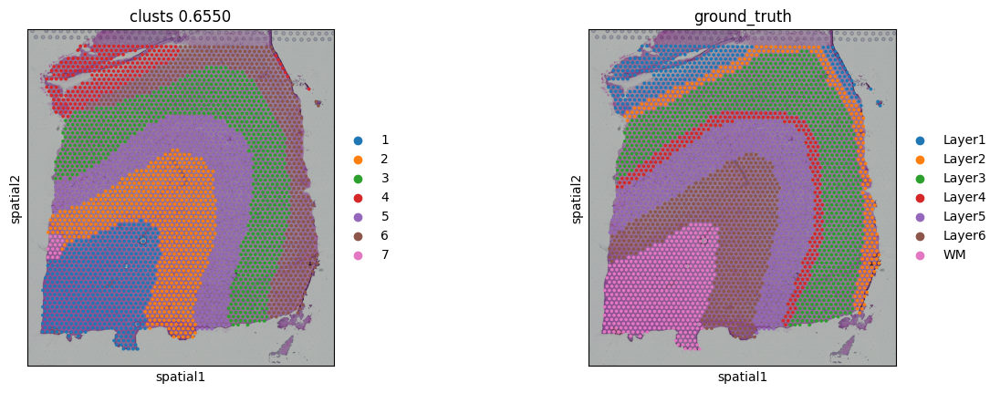

In [62]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)           
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151673_{}_true_2nd.png'.format(GNs))

/tmp/ipykernel_2755068/1849359884.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151673
ARI:  0.3082125248042707


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


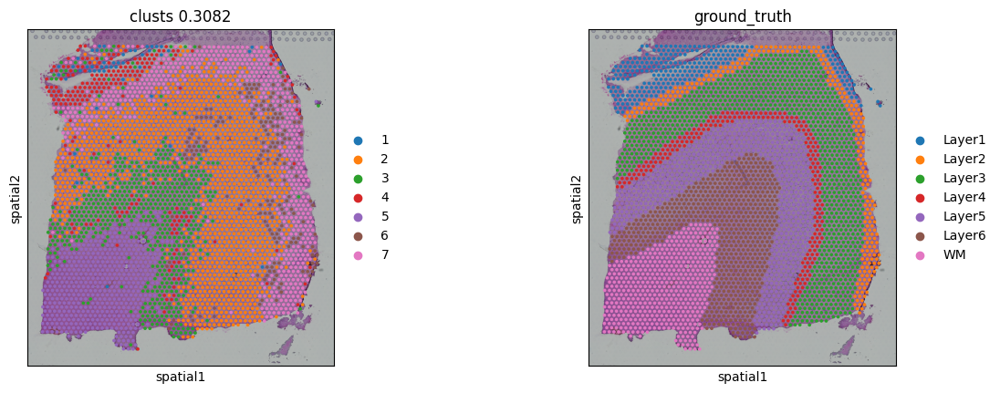

In [63]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151673_{}_active_2nd.png'.format(GNs))                                
                                

/tmp/ipykernel_2755068/3000578138.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151673
ARI:  0.3007326888328498


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


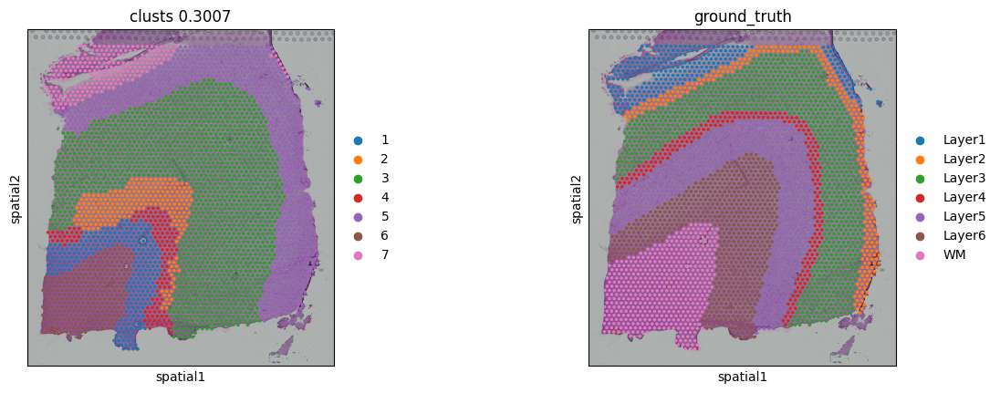

In [64]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151673_{}_newactive_2nd.png'.format(GNs))                              
                                

/tmp/ipykernel_2755068/408658508.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151673
ARI:  0.5369147398097431


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


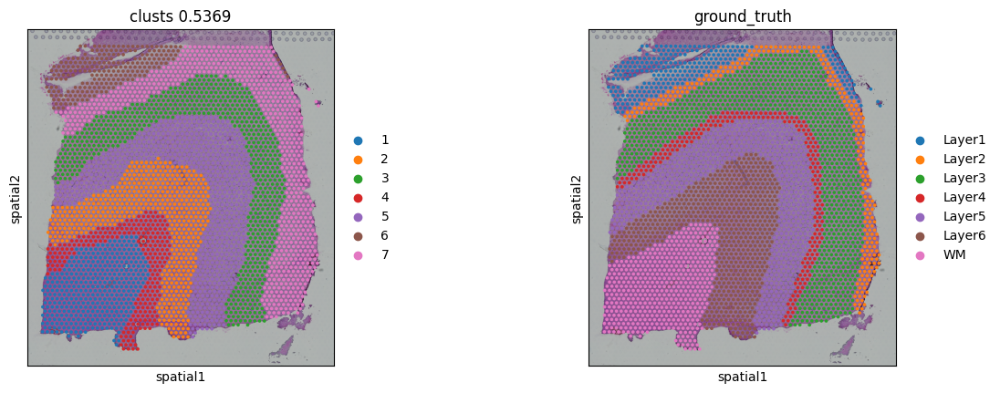

In [65]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151673_{}_test_2nd.png'.format(GNs))                                 
                                

In [66]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2755068/995071248.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151673
ARI:  0.4009489012253901


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


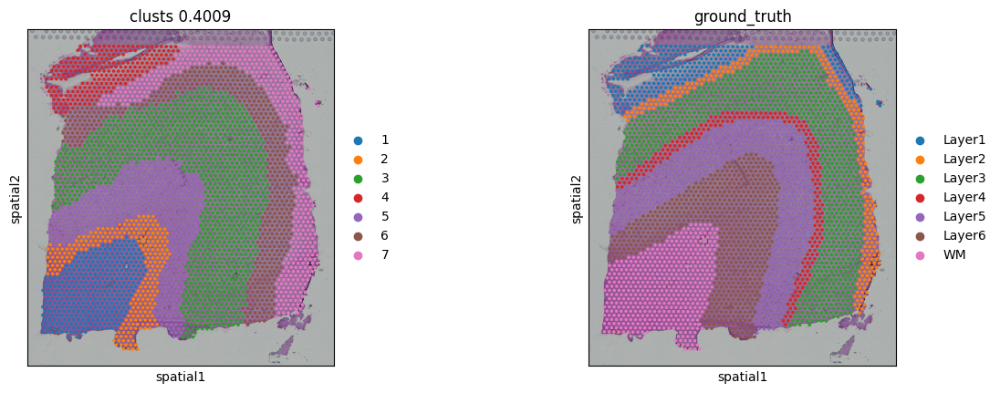

In [67]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151673_{}_actcombine_2nd.png'.format(GNs))                               
                                

<h1>151674 test</h1>

In [42]:
for index in adata_test.var[adata_test.var['highly_variable']==True].index:
    if '-' in index:
        print(index)

/tmp/ipykernel_2755582/2403653168.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151674
ARI:  0.4473407934792577


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


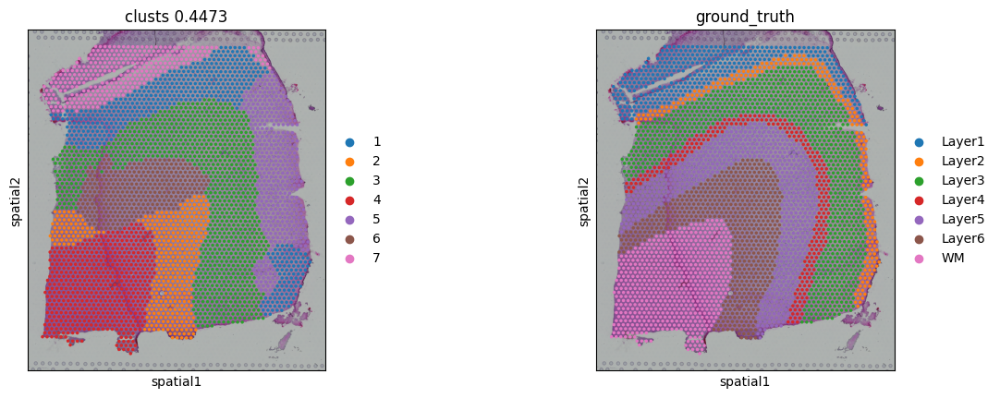

In [43]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)            
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_true.png'.format(GNs))

/tmp/ipykernel_2755582/1385026371.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151674
ARI:  0.2209647345183863


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


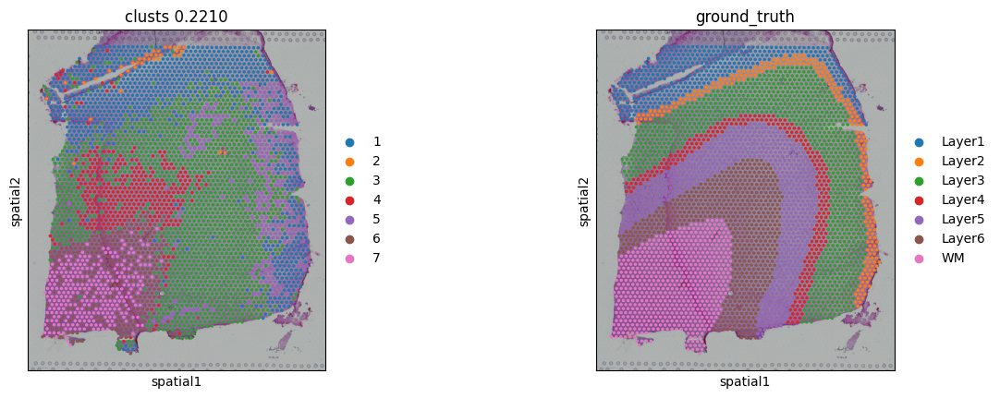

In [44]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_active.png'.format(GNs))                        

/tmp/ipykernel_2755582/1107530411.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151674
ARI:  0.3066030471369261


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


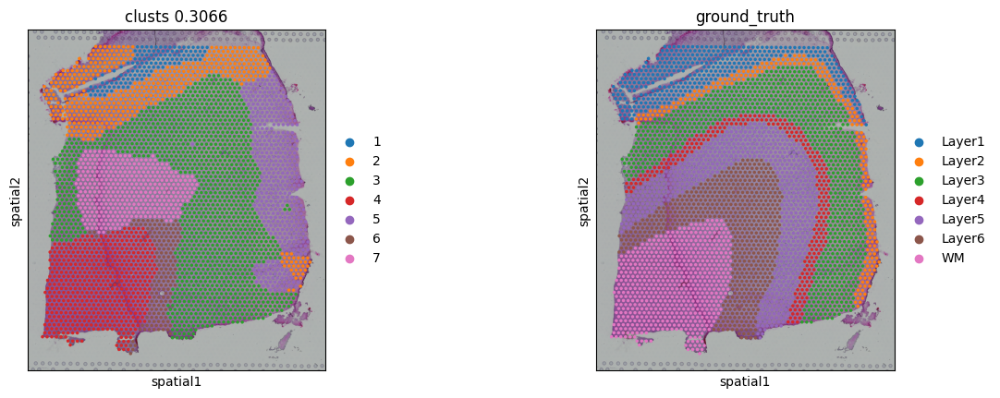

In [45]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_newactive.png'.format(GNs))                                

/tmp/ipykernel_2755582/2815474702.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151674
ARI:  0.2938893134627771


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


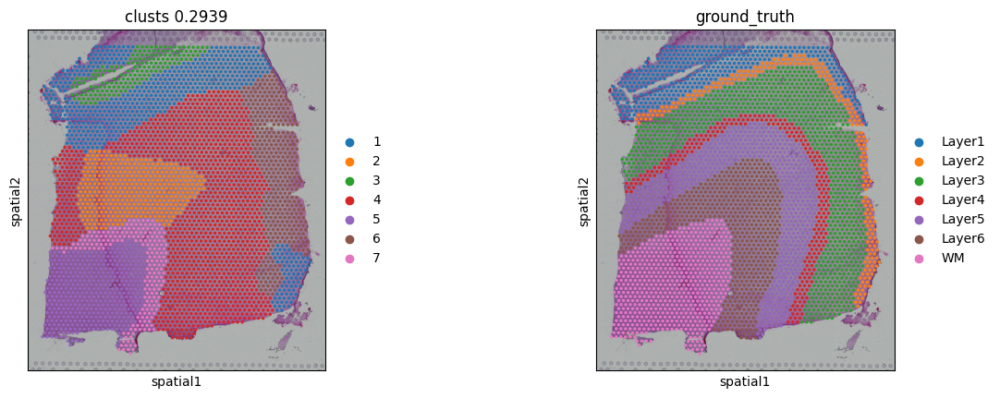

In [46]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_test.png'.format(GNs))                                

In [47]:
# separate test using our pipeline output reprocessed with GraphST (combined)
beer_active_combine.var['highly_variable']= True

In [48]:
model3 = GraphST.GraphST(beer_active_combine, device=device, dim_input=3609)
beer_active_combine = model3.train()

Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:23<00:00, 25.96it/s]


Optimization finished for ST data!


In [49]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2755582/2933029495.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151674
ARI:  0.32383161714910835


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


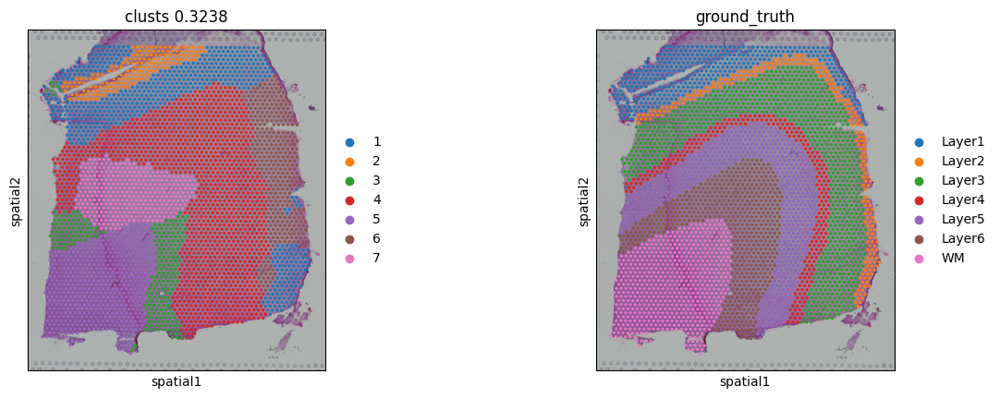

In [50]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151674_{}_actcombine.png'.format(GNs))                                

<h2>2nd run</h2>

In [51]:
if tool == 'mclust':
   clustering(adata_true, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [52]:
if tool == 'mclust':
   clustering(adata_test, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_test, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [53]:
if tool == 'mclust':
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [54]:
beer_active = n_mclust_R(beer_active, used_obsm='X_pca', num_cluster=n_clusters)
beer_active.obs['domain'] = beer_active.obs['mclust']

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2755582/179646693.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151674
ARI:  0.4322327803614284


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


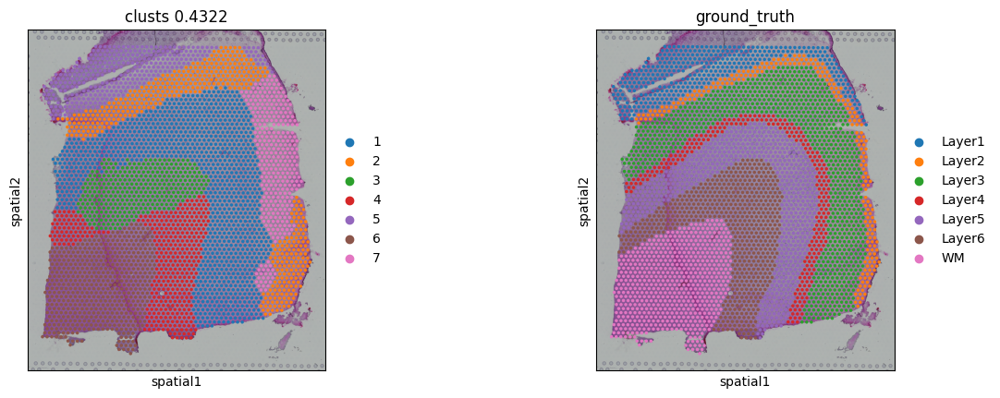

In [55]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)           
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_true_2nd.png'.format(GNs))

/tmp/ipykernel_2755582/4258263430.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151674
ARI:  0.22090861208311327


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


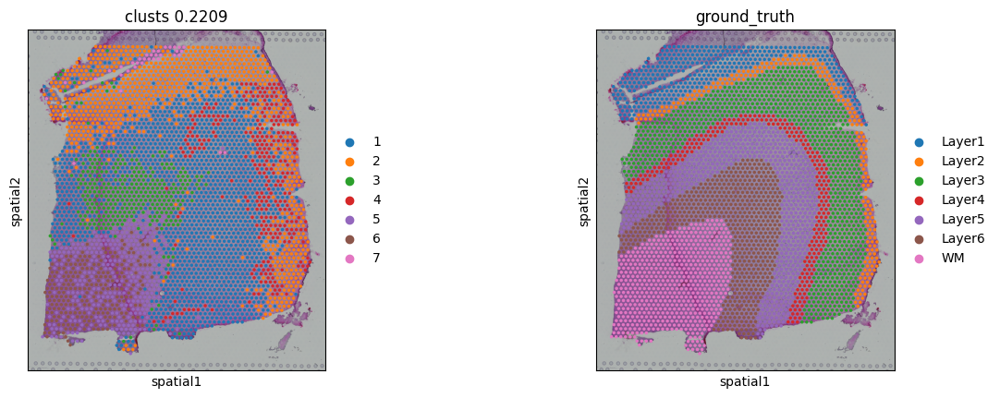

In [56]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_active_2nd.png'.format(GNs))                                
                                

/tmp/ipykernel_2755582/974345011.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151674
ARI:  0.31260687539348764


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


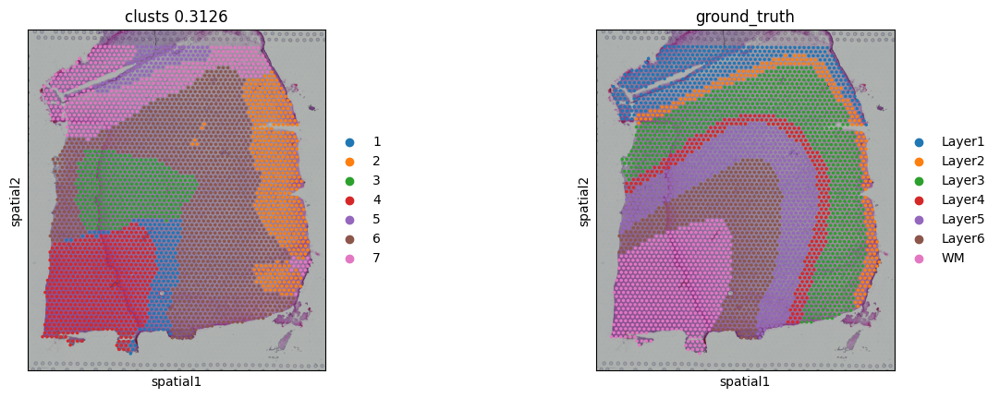

In [57]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_newactive_2nd.png'.format(GNs))                              
                                

/tmp/ipykernel_2755582/1442827770.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151674
ARI:  0.3510333904012774


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


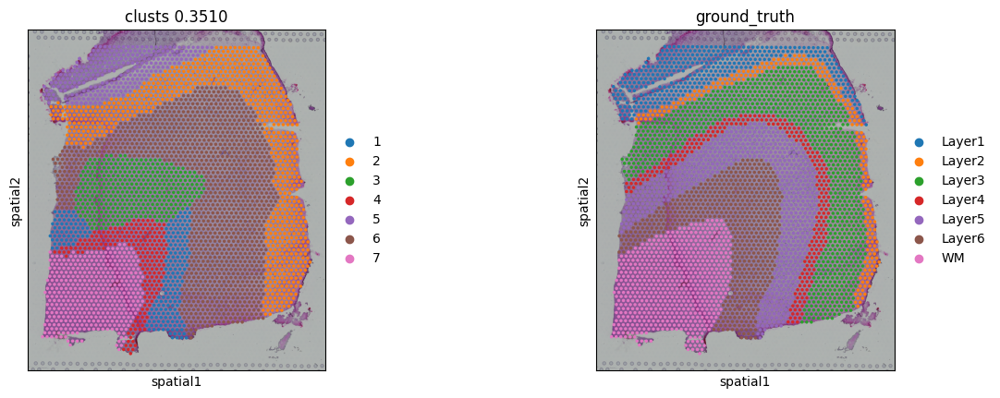

In [58]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_test_2nd.png'.format(GNs))                                 
                                

In [59]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2755582/1608528989.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151674
ARI:  0.3288226182892524


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


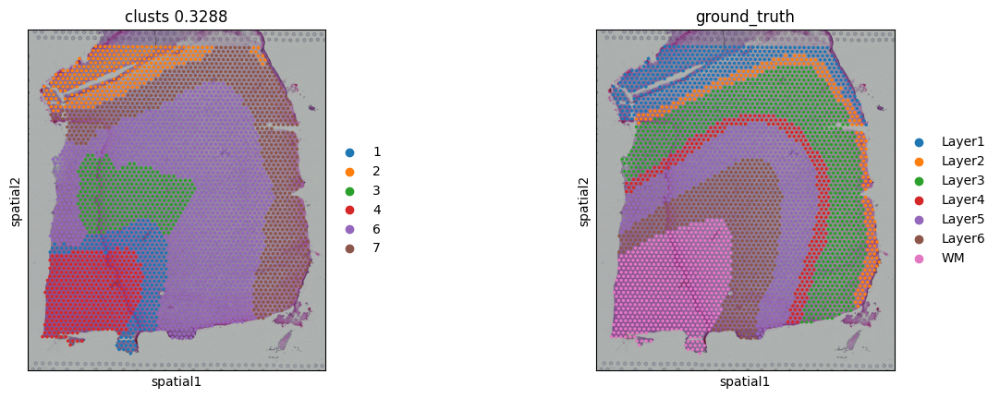

In [60]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save = '_151674_{}_actcombine_2nd.png'.format(GNs))                               
                                

<h1>151675 retests</h1>

/tmp/ipykernel_2756030/3595092063.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151675
ARI:  0.5473845632524573


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


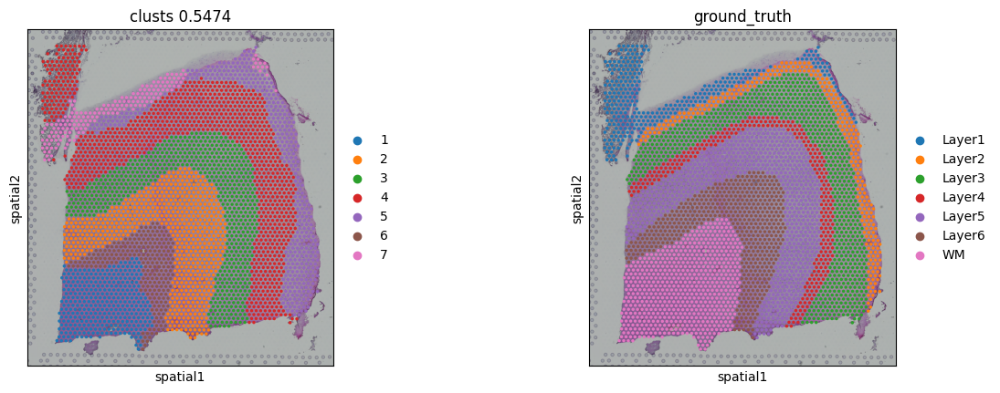

In [42]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_true.png'.format(GNs))                                

/tmp/ipykernel_2756030/623061240.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151675
ARI:  0.27683979818724447


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


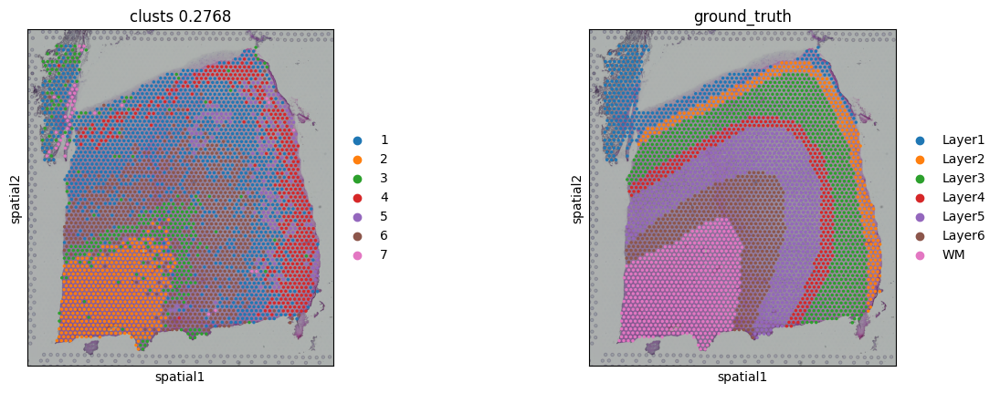

In [43]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_active.png'.format(GNs))                                

/tmp/ipykernel_2756030/3830860886.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151675
ARI:  0.2711187401937336


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


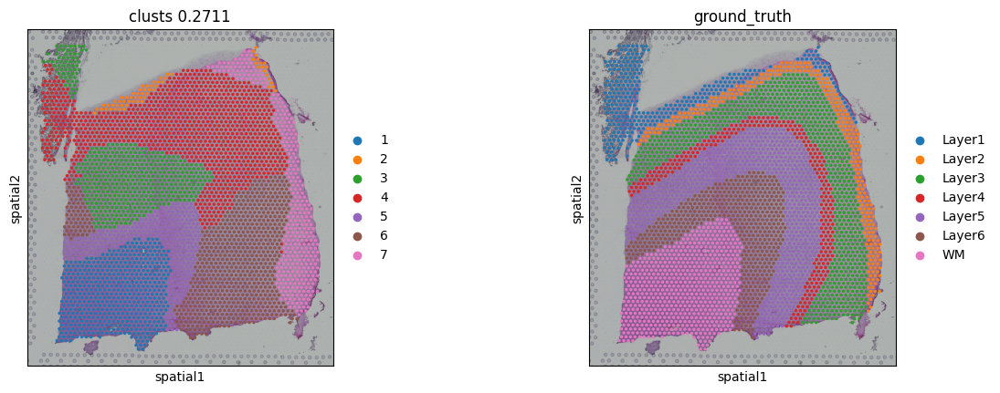

In [44]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_newactive.png'.format(GNs))                                

/tmp/ipykernel_2756030/932898222.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151675
ARI:  0.39740363411678276


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


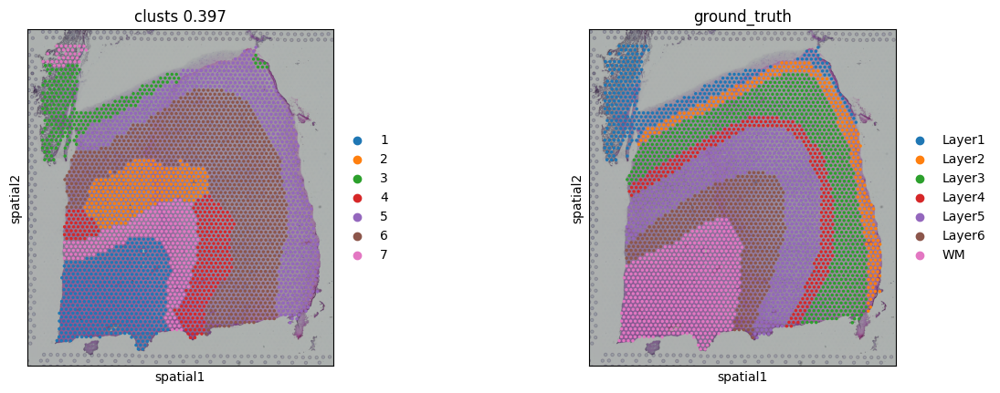

In [45]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_test.png'.format(GNs))                                

In [46]:
# separate test using our pipeline output reprocessed with GraphST (combined)
beer_active_combine.var['highly_variable']= True

In [47]:
beer_active_combine

AnnData object with n_obs × n_vars = 3592 × 4781
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col', 'ground_truth'
    var: 'features', 'highly_variable'
    uns: 'neighbors', 'spatial'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'distances'

In [48]:
model = GraphST.GraphST(beer_active_combine, device=device)
beer_active_combine = model.train()

Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:21<00:00, 28.06it/s]


Optimization finished for ST data!


In [49]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756030/4248854580.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151675
ARI:  0.3552426969091762


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


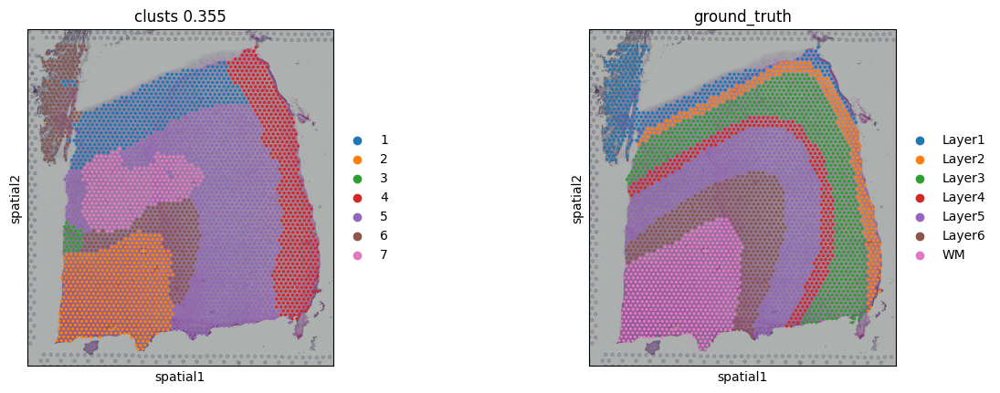

In [50]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_actcombine.png'.format(GNs))                                

<h2>2nd run</h2>

In [51]:
if tool == 'mclust':
   clustering(adata_true, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [52]:
if tool == 'mclust':
   clustering(adata_test, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_test, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [53]:
if tool == 'mclust':
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [54]:
beer_active = n_mclust_R(beer_active, used_obsm='X_pca', num_cluster=n_clusters)
beer_active.obs['domain'] = beer_active.obs['mclust']

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756030/2079227599.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151675
ARI:  0.6240471302761244


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


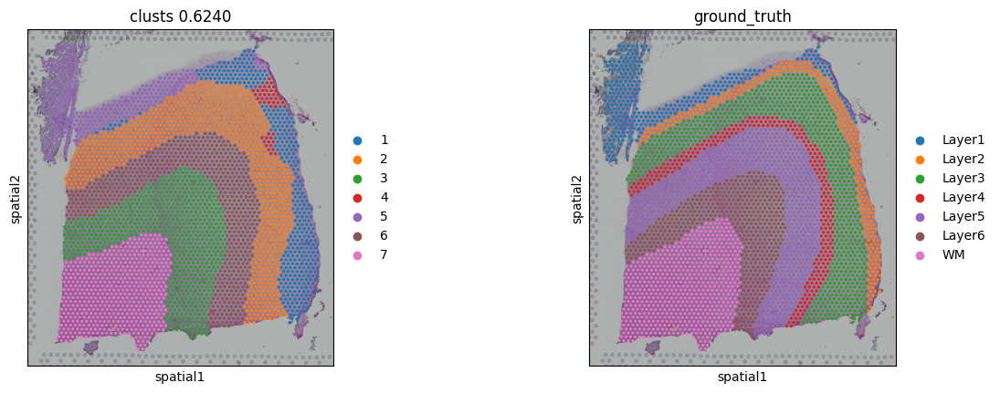

In [55]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)           
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_true_2nd.png'.format(GNs))

/tmp/ipykernel_2756030/3866368299.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151675
ARI:  0.33567400424625154


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


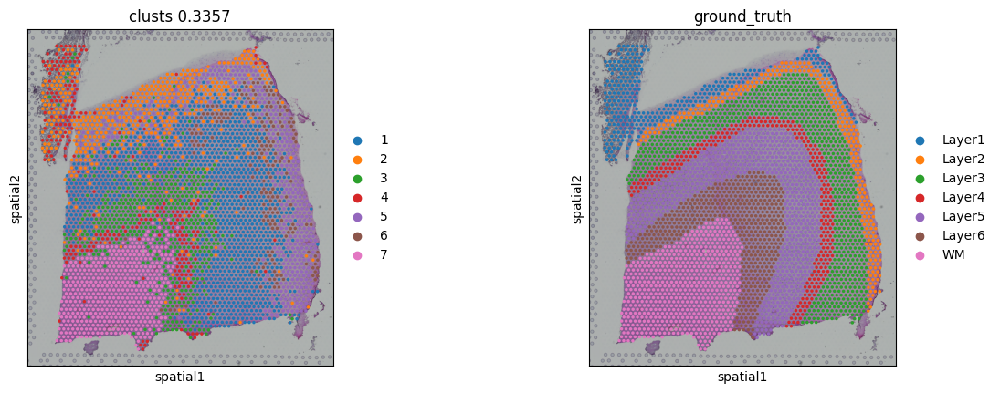

In [56]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_active_2nd.png'.format(GNs))                                
                                

/tmp/ipykernel_2756030/3571088018.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151675
ARI:  0.24278897014687745


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


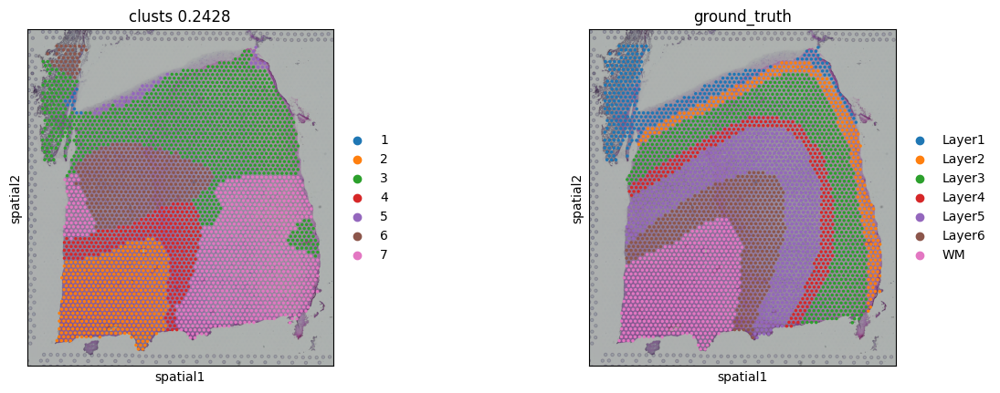

In [57]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_newactive_2nd.png'.format(GNs))                              
                                

/tmp/ipykernel_2756030/308683868.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151675
ARI:  0.43045166392293677


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


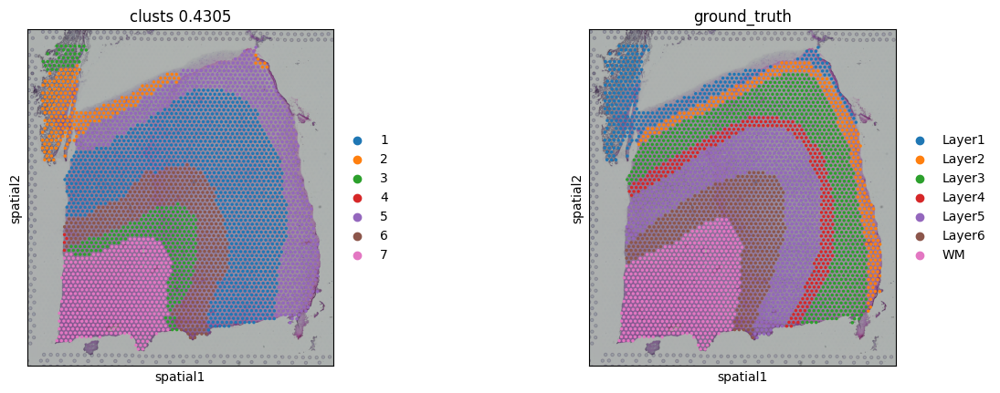

In [58]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_test_2nd.png'.format(GNs))                                 
                                

In [59]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756030/3765694791.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151675
ARI:  0.35832092508971186


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


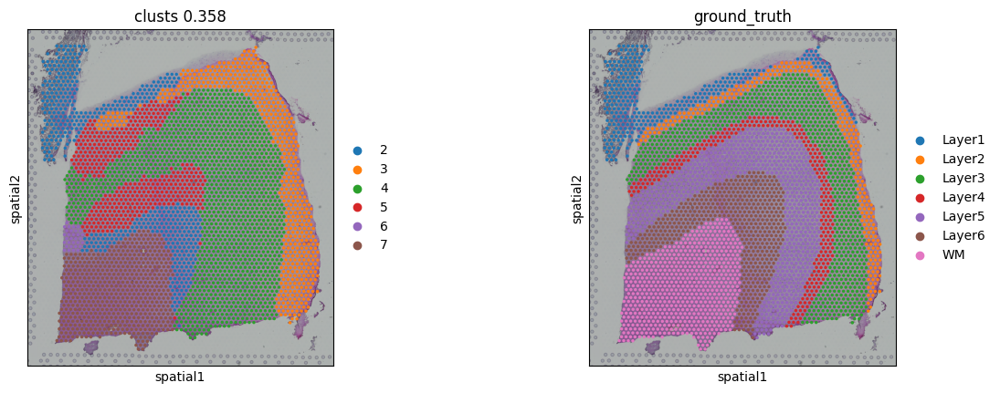

In [60]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151675_{}_actcombine_2nd.png'.format(GNs))                               
                                

<h1>151676 retests</h1>

/tmp/ipykernel_2756480/517426805.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151676
ARI:  0.5556752843265998


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


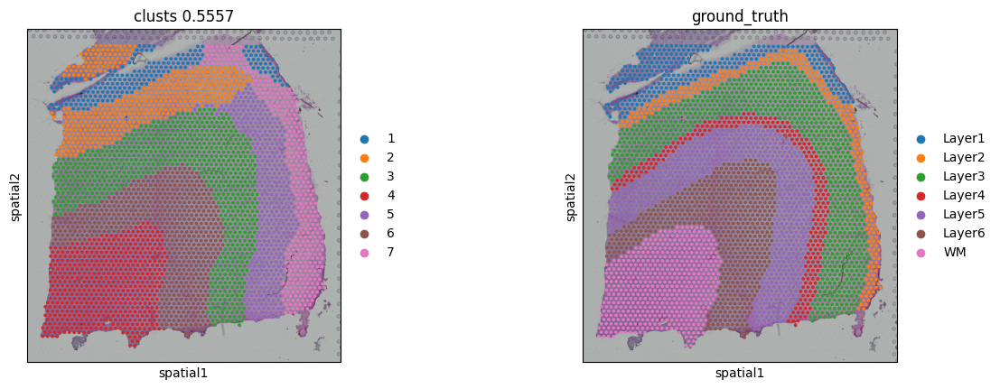

In [42]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_true.png'.format(GNs))                                

/tmp/ipykernel_2756480/459551529.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151676
ARI:  0.25007371549382373


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


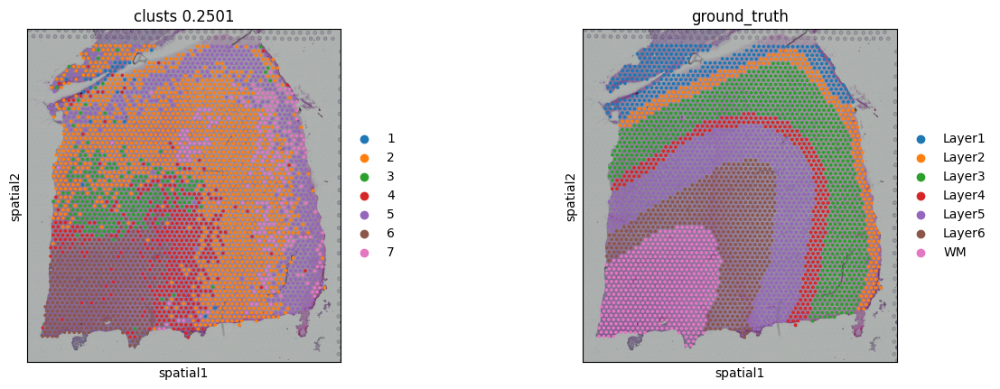

In [44]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_active.png'.format(GNs))                                

/tmp/ipykernel_2756480/3793640654.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151676
ARI:  0.26607703996780413


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


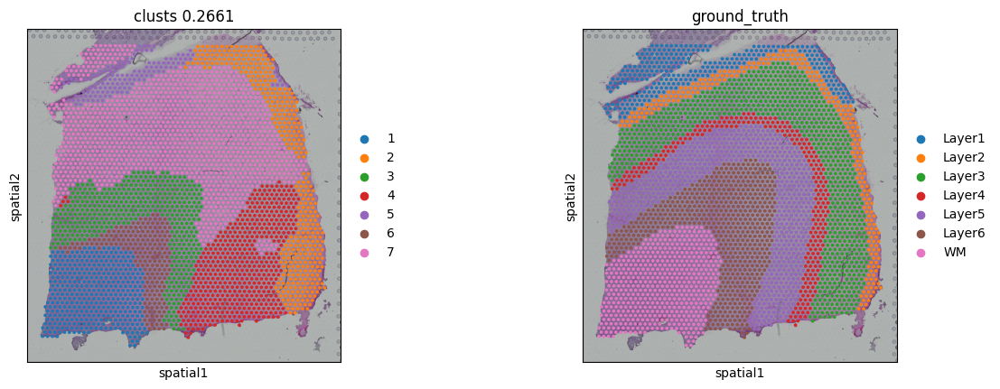

In [45]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_newactive.png'.format(GNs))                                

/tmp/ipykernel_2756480/3793640654.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151676
ARI:  0.26607703996780413


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


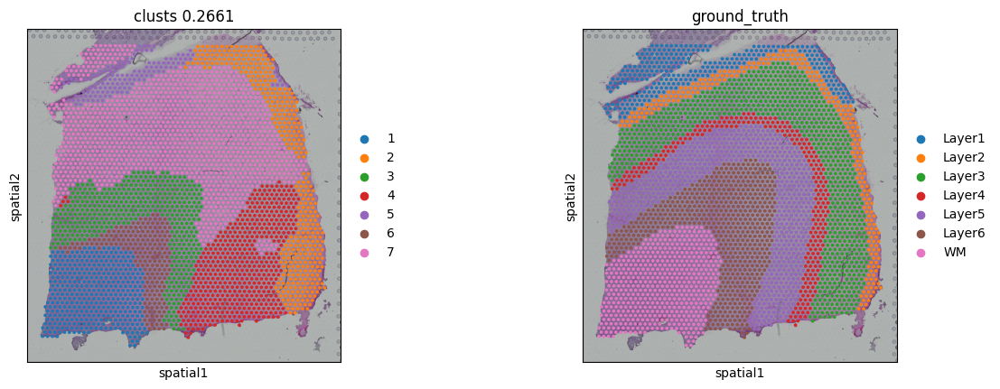

In [46]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_newactive.png'.format(GNs))                                

/tmp/ipykernel_2756480/4074108248.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151676
ARI:  0.34944908914622885


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


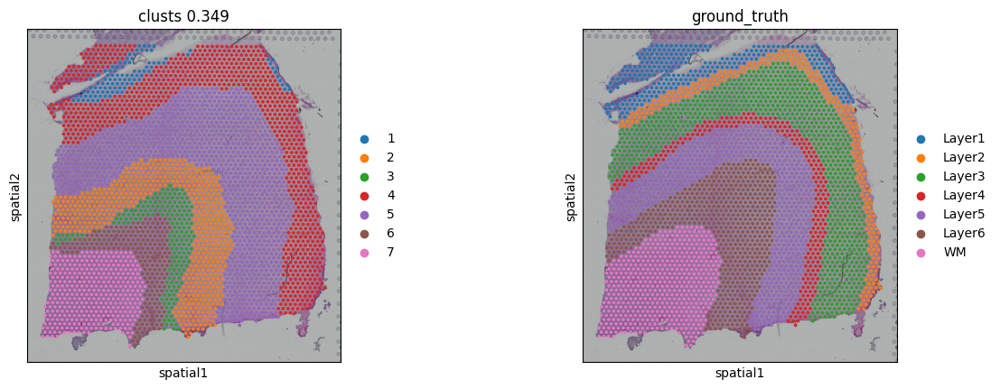

In [47]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_test.png'.format(GNs))                                

In [49]:
# separate test using our pipeline output reprocessed with GraphST (combined)
beer_active_combine.var['highly_variable']= True

In [50]:
beer_active_combine

AnnData object with n_obs × n_vars = 3460 × 4781
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'batch', 'group', 'map', 'RNA_snn_res.0.8', 'seurat_clusters', 'RNA_snn_res.0.5', 'batch_numeric', 'ident_numeric', 'in_tissue', 'array_row', 'array_col', 'ground_truth'
    var: 'features', 'highly_variable'
    uns: 'neighbors', 'spatial'
    obsm: 'X_pca', 'X_umap', 'spatial'
    varm: 'PCs'
    obsp: 'distances'

In [51]:
model = GraphST.GraphST(beer_active_combine, device=device)
beer_active_combine = model.train()

Begin to train ST data...


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 600/600 [00:20<00:00, 28.87it/s]

Optimization finished for ST data!


In [52]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756480/843718747.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151676
ARI:  0.38946440324451403


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


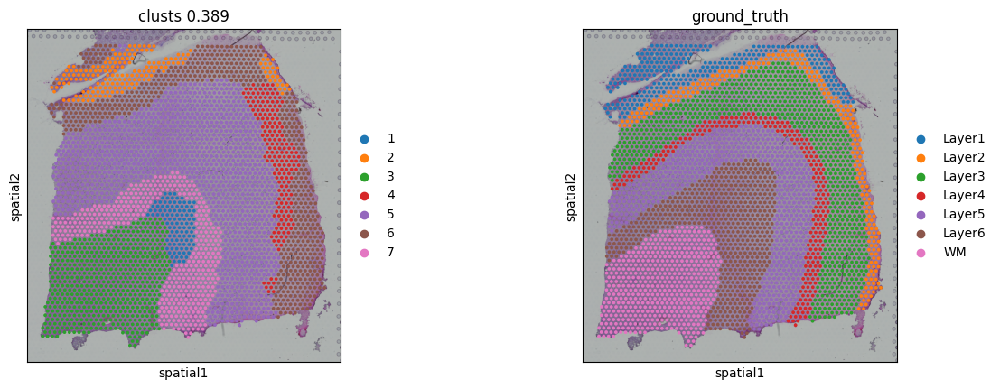

In [53]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_actcombine.png'.format(GNs))                                

<h2>2nd run</h2>

In [54]:
if tool == 'mclust':
   clustering(adata_true, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_true, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [55]:
if tool == 'mclust':
   clustering(adata_test, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(adata_test, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [56]:
if tool == 'mclust':
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(new_beer_active, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


In [57]:
beer_active = n_mclust_R(beer_active, used_obsm='X_pca', num_cluster=n_clusters)
beer_active.obs['domain'] = beer_active.obs['mclust']

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756480/4096408094.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151676
ARI:  0.5720090231870645


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


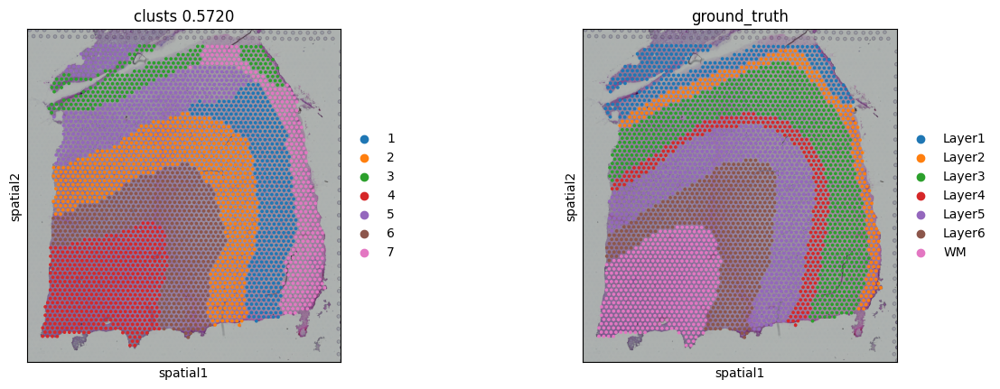

In [58]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)           
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_true_2nd.png'.format(GNs))

/tmp/ipykernel_2756480/16970666.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active.uns['ARI']=ARI
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


Dataset: 151676
ARI:  0.23643352328448647


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


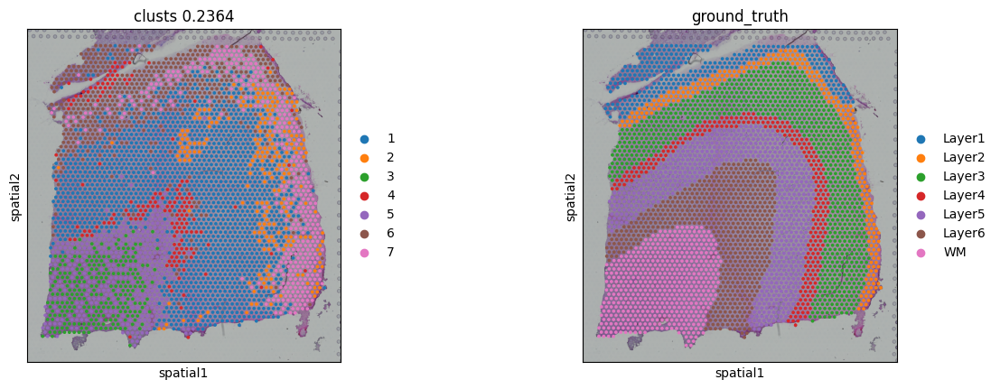

In [59]:
beer_active = beer_active[~pd.isnull(beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active.obs['domain'], beer_active.obs['ground_truth'])
beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_active_2nd.png'.format(GNs))                                
                                

/tmp/ipykernel_2756480/3245914934.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151676
ARI:  0.21666406447825798


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


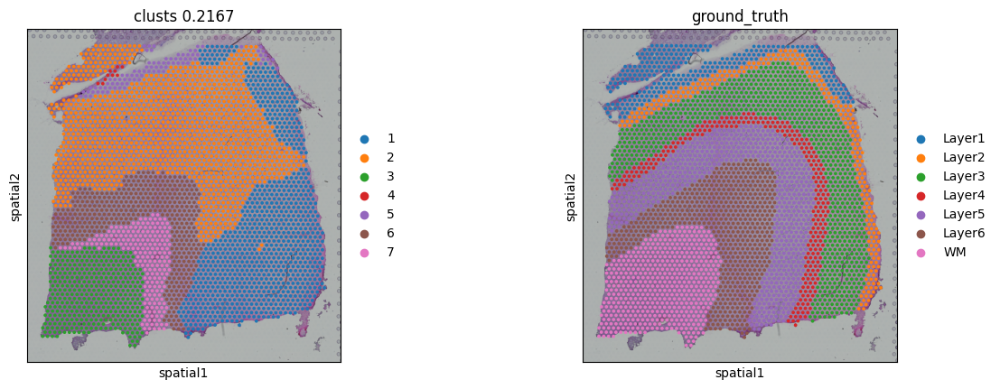

In [60]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_newactive_2nd.png'.format(GNs))                              
                                

/tmp/ipykernel_2756480/3245914934.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_active.uns['ARI']=ARI


Dataset: 151676
ARI:  0.21666406447825798


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


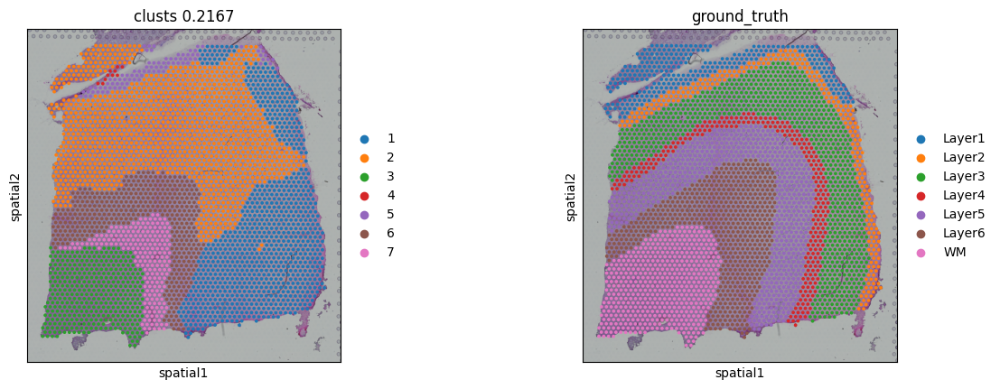

In [61]:
new_beer_active = new_beer_active[~pd.isnull(new_beer_active.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_active.obs['domain'], new_beer_active.obs['ground_truth'])
new_beer_active.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(new_beer_active, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_newactive_2nd.png'.format(GNs))                              
                                

/tmp/ipykernel_2756480/95957816.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151676
ARI:  0.37176548263241826


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


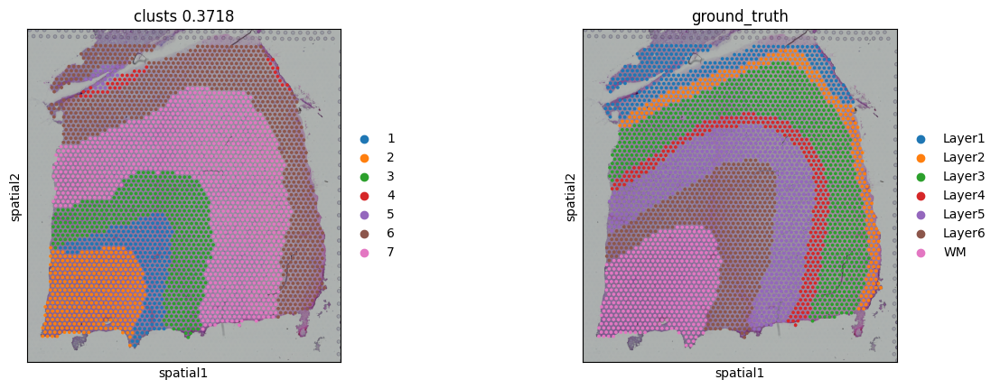

In [62]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_test_2nd.png'.format(GNs))                                 
                                

/tmp/ipykernel_2756480/95957816.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151676
ARI:  0.37176548263241826


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


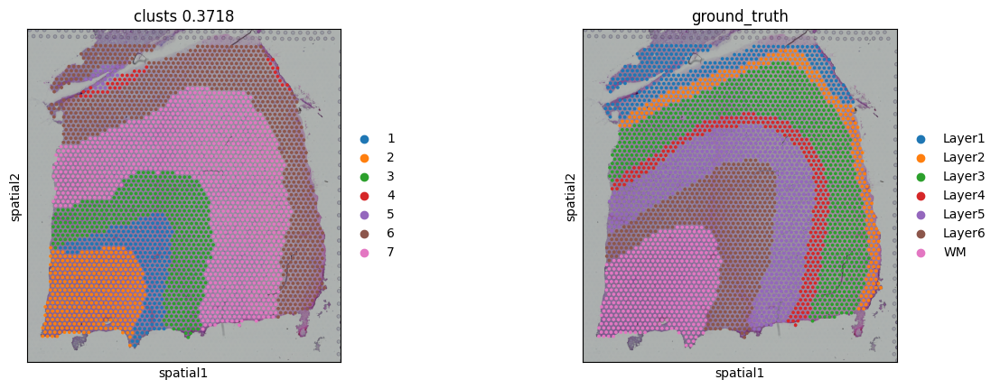

In [63]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_test_2nd.png'.format(GNs))                                 
                                

In [64]:
# n_clusters = 7
if tool == 'mclust':
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, refinement=True) # For DLPFC dataset, we use optional refinement step.
elif tool in ['leiden', 'louvain']:
   clustering(beer_active_combine, n_clusters, radius=radius, method=tool, start=0.1, end=2.0, increment=0.01, refinement=False)

fitting ...
  |======================================================================| 100%


/tmp/ipykernel_2756480/2780124056.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_active_combine.uns['ARI']=ARI


Dataset: 151676
ARI:  0.34915519046844107


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


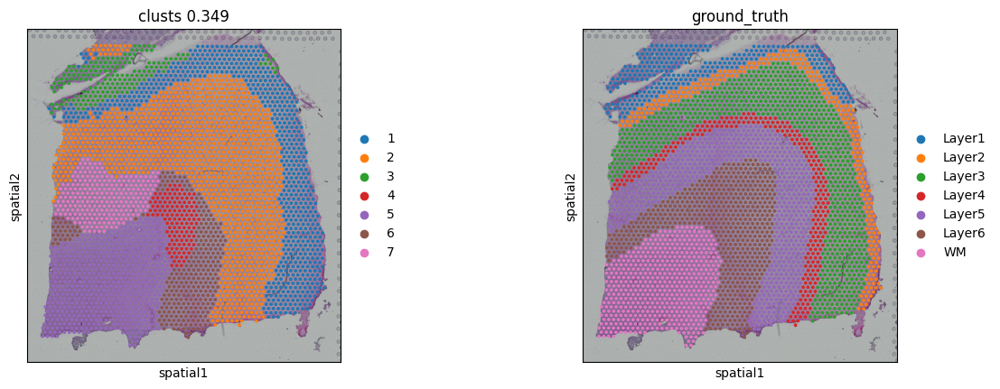

In [65]:
beer_active_combine = beer_active_combine[~pd.isnull(beer_active_combine.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_active_combine.obs['domain'], beer_active_combine.obs['ground_truth'])
beer_active_combine.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
sc.pl.spatial(beer_active_combine, img_key='hires',color=['domain','ground_truth'], title=['clusts %.3f'%ARI, 'ground_truth'],show=True,
             save='_151676_{}_actcombine_2nd.png'.format(GNs))                               
                                

<h1>151675 tests</h1>

In [38]:
adata = adata[~pd.isnull(adata.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata.obs['domain'], adata.obs['ground_truth'])
adata.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

Dataset: 151673
ARI:  0.6549670298306336


/tmp/ipykernel_3318908/1534717464.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns['ARI']=ARI


In [101]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

Dataset: 151673
ARI:  0.4917551088894063


/tmp/ipykernel_1505552/2738171246.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI


In [112]:
adata_true = adata_true[~pd.isnull(adata_true.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_true.obs['domain'], adata_true.obs['ground_truth'])
adata_true.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

Dataset: 151673
ARI:  0.6549670298306336


/tmp/ipykernel_1505552/2738171246.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_true.uns['ARI']=ARI


In [102]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_1505552/2163609175.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151673
ARI:  0.27100876137202534


In [160]:
new_beer_3 = new_beer_3[~pd.isnull(new_beer_3.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(new_beer_3.obs['domain'], new_beer_3.obs['ground_truth'])
new_beer_3.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_1505552/3286969269.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  new_beer_3.uns['ARI']=ARI


Dataset: 151673
ARI:  0.0024450463695293713


In [171]:
beer_3 = beer_3[~pd.isnull(beer_3.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(beer_3.obs['domain'], beer_3.obs['ground_truth'])
beer_3.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_1505552/896310148.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  beer_3.uns['ARI']=ARI


Dataset: 151673
ARI:  0.36075639773289475


In [124]:
test = pd.DataFrame(adata_true.X)
test

,0
0,"(0, 26)\t1.4056534\n (0, 29)\t1.3167695\n ..."
1,"(0, 29)\t4.327612\n (0, 32)\t6.4724536\n (..."
2,"(0, 21)\t2.6749747\n (0, 53)\t1.6854008\n ..."
3,"(0, 39)\t1.6705729\n (0, 43)\t2.2084844\n ..."
4,"(0, 21)\t3.5843992\n (0, 27)\t1.9223138\n ..."
...,...
3606,"(0, 43)\t4.3823414\n (0, 51)\t2.0263374\n ..."
3607,"(0, 15)\t10.0\n (0, 29)\t3.5593538\n (0, 3..."
3608,"(0, 27)\t2.6619387\n (0, 29)\t2.8160868\n ..."
3609,"(0, 29)\t3.8128297\n (0, 38)\t10.0\n (0, 4..."


In [113]:
adata_test = adata_test[~pd.isnull(adata_test.obs['ground_truth'])]

ARI = metrics.adjusted_rand_score(adata_test.obs['domain'], adata_test.obs['ground_truth'])
adata_test.uns['ARI']=ARI

print('Dataset:', dataset)
print('ARI: ', ARI)
                                  
                                

/tmp/ipykernel_1505552/2163609175.py:4: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata_test.uns['ARI']=ARI


Dataset: 151673
ARI:  0.20595949898881513


/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


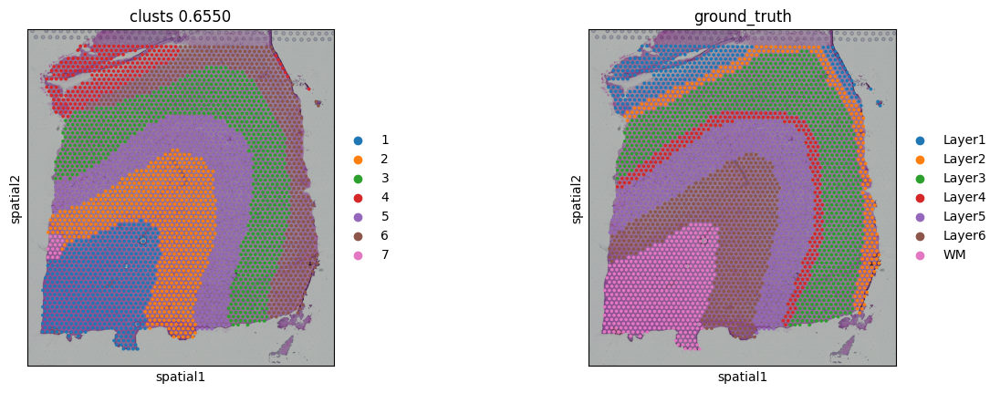

In [44]:
sc.pl.spatial(adata, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True)

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


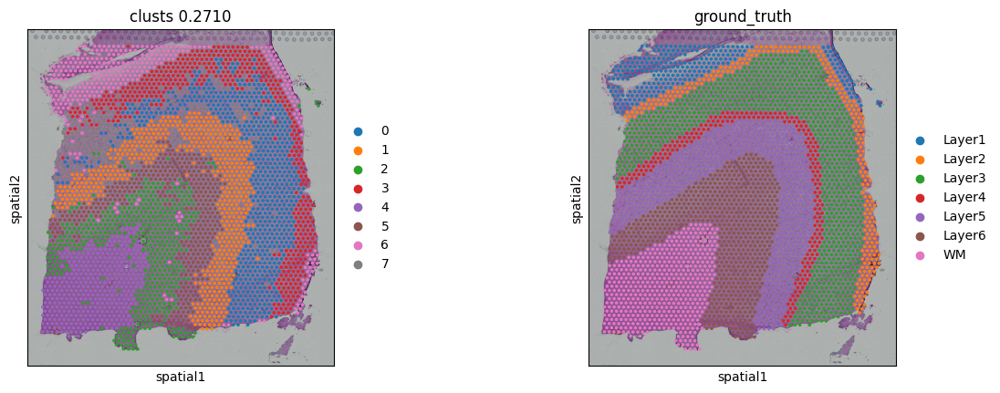

In [103]:
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True)

/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/opt/conda/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


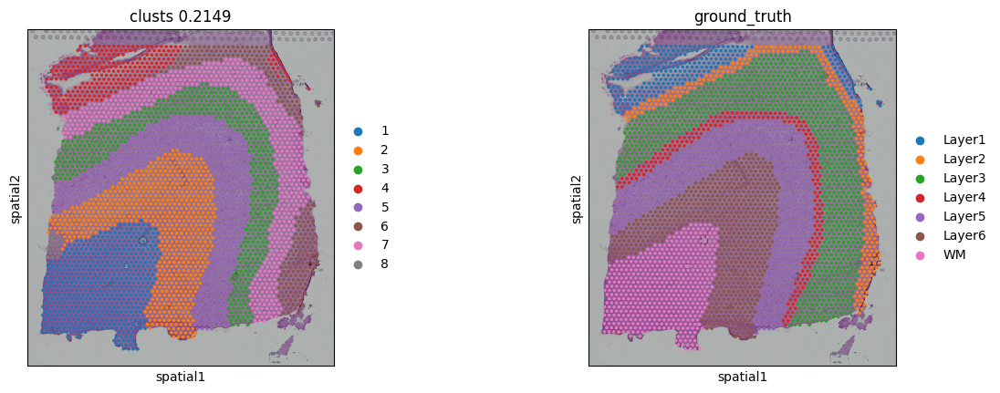

In [109]:
sc.pl.spatial(adata_true, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True)

In [90]:
sc.pl.spatial(adata_test, img_key='hires',color=['domain','ground_truth'], title=['clusts %.4f'%ARI, 'ground_truth'],show=True)

ValueError: When .uns['spatial'][library_id] does not exist, spot_size must be provided directly.

In [45]:
print(pd.__version__)

2.2.0


--------------

In [28]:
vars_data = sc.read_h5ad(data_folder+'/scRNA.h5ad')

In [29]:
vars_data.obs['cell_type']

Ex_10_L2_4.3_Control_B3_AAACCTGAGGTAGCCA           Ex_10_L2_4
Inhib_5.3_Control_B3_AAACCTGCAAACTGTC                 Inhib_5
Ex_10_L2_4.3_Control_B3_AAACCTGCAACAACCT           Ex_10_L2_4
Ex_8_L5_6.3_Control_B3_AAACCTGGTCCGAACC             Ex_8_L5_6
Inhib_2_VIP.3_Control_B3_AAACCTGGTCGTGGCT         Inhib_2_VIP
                                                    ...      
OPCs_1.17_Suicide_B1_TTTGTCAAGCTCCTTC                  OPCs_1
Ex_10_L2_4.17_Suicide_B1_TTTGTCAAGGCTAGCA          Ex_10_L2_4
Ex_10_L2_4.17_Suicide_B1_TTTGTCAAGGGATGGG          Ex_10_L2_4
Inhib_2_VIP.17_Suicide_B1_TTTGTCACATGTCCTC        Inhib_2_VIP
Inhib_7_PVALB.17_Suicide_B1_TTTGTCAGTAAGTGGC    Inhib_7_PVALB
Name: cell_type, Length: 78886, dtype: category
Categories (33, object): ['Astros_1', 'Astros_2', 'Astros_3', 'Endo', ..., 'OPCs_2', 'Oligos_1', 'Oligos_2', 'Oligos_3']

In [31]:
vars_data.X

<78886x30062 sparse matrix of type '<class 'numpy.float32'>'
	with 143206462 stored elements in Compressed Sparse Column format>

In [36]:
ada_test = sc.read_10x_h5(data_folder + '/filtered_feature_bc_matrix.h5')
ada_test.var_names_make_unique()
ada_test

/opt/conda/lib/python3.10/site-packages/anndata/_core/anndata.py:1832: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 3639 × 33538
    var: 'gene_ids', 'feature_types', 'genome'

In [37]:
ada_test.var

,gene_ids,feature_types,genome
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38
FAM138A,ENSG00000237613,Gene Expression,GRCh38
OR4F5,ENSG00000186092,Gene Expression,GRCh38
AL627309.1,ENSG00000238009,Gene Expression,GRCh38
AL627309.3,ENSG00000239945,Gene Expression,GRCh38
...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38
AC233755.1,ENSG00000275063,Gene Expression,GRCh38
AC240274.1,ENSG00000271254,Gene Expression,GRCh38
AC213203.1,ENSG00000277475,Gene Expression,GRCh38


In [38]:
adata.var

,gene_ids,feature_types,genome
MIR1302-2HG,ENSG00000243485,Gene Expression,GRCh38
FAM138A,ENSG00000237613,Gene Expression,GRCh38
OR4F5,ENSG00000186092,Gene Expression,GRCh38
AL627309.1,ENSG00000238009,Gene Expression,GRCh38
AL627309.3,ENSG00000239945,Gene Expression,GRCh38
...,...,...,...
AC233755.2,ENSG00000277856,Gene Expression,GRCh38
AC233755.1,ENSG00000275063,Gene Expression,GRCh38
AC240274.1,ENSG00000271254,Gene Expression,GRCh38
AC213203.1,ENSG00000277475,Gene Expression,GRCh38


In [39]:
adata.var.equals(ada_test.var)

True